In [18]:
%matplotlib

Using matplotlib backend: QtAgg


In [19]:
import statistics
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import ShuffleSplit, cross_val_score

from mne import Epochs, pick_types, events_from_annotations
from mne.channels import make_standard_montage
from mne.io import concatenate_raws, read_raw_edf
from mne.datasets import eegbci
from mne.decoding import CSP

import pyxdf
import mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy
from scipy import stats


import os

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap)

from tqdm import tqdm_notebook

from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GroupKFold,GridSearchCV,cross_val_score,cross_validate 

In [20]:
# Функции для выгрузки файлов и создание нормального raw формата для использования mne

%matplotlib

def show_streams(content):
    streams_names = [i['info']['name'][0] for i in content]
    print(f'Available streams: {streams_names}')
    
def get_stream(name, content):
    streams_names = [i['info']['name'][0] for i in content]
    if name not in streams_names:
        raise NameError(f'Stream {name} is not in the list.\nAvailable streams: {streams_names}')
    sdata = content[streams_names.index(name)]

    data = sdata['time_series']
    ts = sdata['time_stamps']

    print('Reading stream: ', sdata['info']['name'][0])
    print(f'Recording duration: {ts[-1] - ts[0]} sec')
    print('Effective sampling rate: ', data.shape[0] / (ts[-1] - ts[0]), '\n')
    global freq_1
    freq_1=data.shape[0] / (ts[-1] - ts[0])
    print('Data shape:', data.shape)
    return {'data': data,
            'ts': ts,
            'info':{k:v for k,v in sdata['info'].items() if k != 'desc'},
            'channels': [i['label'][0] for i in sdata['info']['desc'][0]['channels'][0]['channel']]
            }
def get_stream_events(name, content):
    streams_names = [i['info']['name'][0] for i in content]
    if name not in streams_names:
        raise NameError(f'Stream {name} is not in the list.\nAvailable streams: {streams_names}')
    sdata = content[streams_names.index(name)]

    data = sdata['time_series']
    ts = sdata['time_stamps']

    print('Reading stream: ', sdata['info']['name'][0])
    print(f'Recording duration: {ts[-1] - ts[0]} sec')
    print('Effective sampling rate: ', data.shape[0] / (ts[-1] - ts[0]), '\n')
    #global freq_2
    #freq_2=data.shape[0] / (ts[-1] - ts[0])
    print('Data shape:', data.shape)
    return {'data': data,
            'ts': ts,
            'info':{k:v for k,v in sdata['info'].items() if k != 'desc'},
            }

def makeMontage(raw):
    mne.rename_channels(raw.info,{'Right AUX' : 'A2'})
    raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
    #Нарисуем 2д наш монтаж
    # Form the 10-20 montage
    mont1020 = mne.channels.make_standard_montage('standard_1020')
    # Choose what channels you want to keep 
    # Make sure that these channels exist e.g. T1 does not exist in the standard 10-20 EEG system!
    kept_channels = ['AF7', 'AF8', 'TP9', 'TP10', 'A2']
    ind = [i for (i, channel) in enumerate(mont1020.ch_names) if channel in kept_channels]
    mont1020_new = mont1020.copy()
    # Keep only the desired channels
    mont1020_new.ch_names = [mont1020.ch_names[x] for x in ind]
    kept_channel_info = [mont1020.dig[x+3] for x in ind]
    # Keep the first three rows as they are the fiducial points information
    mont1020_new.dig = mont1020.dig[0:3]+kept_channel_info
    #mont1020_new.plot()
    raw.set_montage(mont1020_new)
    
#выгружаем ээг с событиями и ставим разные события для 1-back и 2-back
def fileLoad(xdffile):
    # Read xdf
    content, header = pyxdf.load_xdf(xdffile, synchronize_clocks=True, dejitter_timestamps=False)
    show_streams(content)
    # Load streams separately 
    eeg = get_stream('Muse-3395 (00:55:da:b7:33:95) EEG', content)
    events = get_stream_events('MyMarkerStream', content)
    print(freq_1)
    #freq_2)
    # Access data 
    eeg_data = eeg['data'] # numpy array (samples, n_channels)
    #Reduce amplitude
    eeg_data = eeg['data'] / 100000000
    eeg_ts = eeg['ts'] # timestamps are already synchronized among the streams at these point
    events_data = events['data']
    events_ts=events['ts']
    info=mne.create_info(eeg['channels'],freq_1)
    data=np.transpose(eeg['data'])
    print('events and eeg ts: ', events_ts, eeg_ts)
    events_d = [0]
    # данные событий в т ч 0 начало записи
    for i in events_data:
        events_d.append(int(i))
    print('Events + 0 event',events_d,'количество событий:', len(events_d))
    #находим индексы ивентов (соответсвующие индексам точек ээг)
    #т.е. temp это таймстемп
    temp_events,temp_eeg=events_ts.copy(),eeg_ts.copy()
    event_index=[0]
    
    for i in temp_events:
        for jr in range(len(temp_eeg)):
            if i - temp_eeg[jr] <= 0.1:
                event_index.append(jr)
                break
    #make events
    zerolist = [0 for _ in range(47)]
    events = []
    print('event_index: ',len(event_index), event_index)
    print('temp_events', len(temp_events), temp_events)
    for i in range(27):
        events.append([event_index[i], zerolist[i], events_d[i]])
    for i in range(27, 47):
        events.append([event_index[i], zerolist[i], 6])
    events = np.array(events)
    info=mne.create_info(eeg['channels'],freq_1)
    data=np.transpose(eeg_data)
    raw=mne.io.RawArray(data,info)
    raw.pick(['all']).load_data()
    makeMontage(raw)
    #filter
    raw = raw.filter(picks=['AF7', 'AF8', 'TP9', 'TP10', 'A2'],l_freq=1, h_freq=50)
    raw.set_eeg_reference(ref_channels=['A2'])
    #raw.plot(events=events)
    return(raw, events)
    #print(event_index)
#plot
#raw=mne.io.RawArray(data,info)
#raw.plot()


Using matplotlib backend: QtAgg


In [21]:
#создадим словари с ЭЭГ и с событиями по всем людям
path_dir = "G:\\.shortcut-targets-by-id\\166Cp9_JW_szly6kshNpaIVJxZumVwx43\\Easy EEG\\Data\\SeptemberOctober\\Muse"

dir_list = os.listdir(path_dir)
#dir_list.remove('desktop.ini')

dir_list.remove('Alice6octMuse.xdf')

raw_list = {}
events_list = {}
names=[]
for i in dir_list:
    name = i[:5]
    print(name)
    names.append(name)
    raw, events = fileLoad(path_dir+'\\'+i)
    raw.pick(['all']).load_data()
    raw_list[name] = raw
    events_list[name] = events
    text = '\n'+ name + "succesful" + '\n'
    print(text)
raw_list

Almaz
Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 294.5264246906736 sec
Effective sampling rate:  256.0313563687783 

Data shape: (75408, 5)
Reading stream:  MyMarkerStream
Recording duration: 264.23604358016746 sec
Effective sampling rate:  0.1740867724809235 

Data shape: (46, 1)
256.0313563687783
events and eeg ts:  [403873.72606381 403878.72555003 403882.52558418 403942.52491764
 403948.34264175 404009.3250005  404016.29189959 404020.56478722
 404023.37496928 404026.39876373 404029.30948059 404032.08494764
 404035.0146866  404037.89700805 404040.81393431 404043.72780276
 404046.69242312 404049.53311937 404052.39412053 404055.52707368
 404058.29446733 404061.17632129 404063.99334725 404066.811714
 404069.79990196 404072.66040491 404077.80810783 404082.09820426
 404086.3935033  404089.24533805 404091.99408871 404095.02464786
 404097.91733112 404100.98245827 404103.99450862 404107.169

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 324.9918247460737 sec
Effective sampling rate:  256.0310557504424 

Data shape: (83208, 5)
Reading stream:  MyMarkerStream
Recording duration: 258.35326072745374 sec
Effective sampling rate:  0.17805078159445828 

Data shape: (46, 1)
256.0310557504424
events and eeg ts:  [229077.3946361  229084.09523356 229087.52836054 229147.52811515
 229153.77914331 229214.76140442 229220.62545638 229224.89936565
 229227.79617573 229230.48488991 229233.1643372  229235.86623898
 229238.56787766 229241.23477934 229243.98294913 229246.71428621
 229249.44643809 229252.08404607 229254.78104896 229257.61474184
 229260.39821952 229263.0959951  229265.87875258 229268.56355327
 229271.25138665 229273.99521123 229277.99428531 229282.26710428
 229286.56404265 229289.39855013 229292.08248611 229294.8371935
 229297.70311288 229300.56590026 229303.31523754 229306.1372746

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 350.5478197565535 sec
Effective sampling rate:  256.0563636149157 

Data shape: (89760, 5)
Reading stream:  MyMarkerStream
Recording duration: 283.4124668504519 sec
Effective sampling rate:  0.1623076095106035 

Data shape: (46, 1)
256.0563636149157
events and eeg ts:  [233317.87401456 233325.4246898  233331.15793041 233391.15903647
 233396.12747203 233457.10788146 233466.91201326 233471.19587236
 233474.4975249  233477.69244943 233480.59201743 233483.70031855
 233486.67895547 233490.07460201 233492.92941741 233495.81533021
 233498.95199914 233501.75909704 233504.79714185 233507.69587516
 233510.60839847 233513.62938058 233516.6462838  233519.82497222
 233522.56462932 233525.47909362 233538.61796916 233542.91029476
 233547.21450787 233550.62748051 233553.92692165 233557.14597328
 233560.11468369 233563.51842583 233566.56208784 233569.66729807

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 301.04996077838587 sec
Effective sampling rate:  256.02394964847224 

Data shape: (77076, 5)
Reading stream:  MyMarkerStream
Recording duration: 256.0696900076873 sec
Effective sampling rate:  0.17963859759668965 

Data shape: (46, 1)
256.02394964847224
events and eeg ts:  [247077.2044806  247080.87238981 247082.78850766 247142.78719148
 247144.52138524 247205.50468578 247209.29989488 247213.57042505
 247216.45730643 247221.00950597 247224.55546409 247228.14749921
 247231.44114726 247234.7038485  247237.58894698 247240.37630436
 247243.29507203 247246.05629461 247248.88879089 247251.70578717
 247254.60997505 247257.50493642 247260.49515999 247263.71620364
 247266.65451441 247269.71414737 247274.04935003 247278.34004799
 247282.63892656 247285.54094653 247288.460003   247291.34878978
 247294.20880536 247297.15600103 247300.20549749 247302.9423

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 296.53473526862217 sec
Effective sampling rate:  256.03745858380694 

Data shape: (75924, 5)
Reading stream:  MyMarkerStream
Recording duration: 261.9506947849004 sec
Effective sampling rate:  0.17560556591679471 

Data shape: (46, 1)
256.03745858380694
events and eeg ts:  [163557.45609981 163564.97218618 163567.8294411  163627.8373392
 163630.00548652 163690.98835883 163695.76509287 163698.90988089
 163702.12857732 163704.97141724 163707.72154537 163710.58285849
 163713.34396061 163716.62254924 163719.64415497 163722.46513059
 163725.27639621 163728.32122004 163731.32616726 163734.32743659
 163737.10624351 163740.07654394 163742.87977506 163745.93896679
 163748.79739471 163751.70717173 163756.95667918 163759.9760063
 163763.31443913 163766.84107656 163770.09171469 163773.44144821
 163776.49141164 163779.89040947 163783.2744004  163786.396515

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 350.50518810286303 sec
Effective sampling rate:  256.0190349412606 

Data shape: (89736, 5)
Reading stream:  MyMarkerStream
Recording duration: 276.33417985393316 sec
Effective sampling rate:  0.1664651112805337 

Data shape: (46, 1)
256.0190349412606
events and eeg ts:  [220357.29867875 220362.58306927 220370.76706289 220430.76480168
 220437.86496737 220498.84771639 220506.86414411 220509.98200409
 220513.00569357 220516.01871005 220519.11752453 220522.41042949
 220525.26782519 220528.09939489 220531.04890567 220533.93842837
 220536.70865267 220539.49991567 220542.24924887 220545.13259496
 220548.05721705 220550.89830525 220553.73820344 220556.53630164
 220559.31521824 220562.21966774 220572.3950637  220575.43423549
 220578.43313307 220581.20085397 220584.62095243 220587.92095399
 220591.33755154 220594.88410029 220598.53427513 220601.875491

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 330.01618798020354 sec
Effective sampling rate:  256.023804520366 

Data shape: (84492, 5)
Reading stream:  MyMarkerStream
Recording duration: 287.5064530744712 sec
Effective sampling rate:  0.15999640880437865 

Data shape: (46, 1)
256.023804520366
events and eeg ts:  [85836.03321655 85841.35009246 85856.65042879 85916.64842554
 85922.06595354 85983.04841218 85996.34709285 86000.62098577
 86003.74903682 86006.67753977 86009.45301422 86012.22598867
 86015.05003732 86017.69988757 86020.33728793 86023.10635888
 86025.89000073 86028.63246788 86031.62173683 86034.57120588
 86037.33285433 86040.13475338 86043.19151783 86046.06573168
 86048.70284583 86051.38432918 86059.23396005 86063.51773837
 86067.8207442  86071.23459134 86075.80109876 86079.0358841
 86083.52125262 86086.71852637 86089.63534232 86092.73735636
 86096.0036491  86099.10223395 86102

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 313.0478243567486 sec
Effective sampling rate:  256.02477884868966 

Data shape: (80148, 5)
Reading stream:  MyMarkerStream
Recording duration: 281.29972683997767 sec
Effective sampling rate:  0.16352664297526287 

Data shape: (46, 1)
256.02477884868966
events and eeg ts:  [93803.72671731 93816.57583408 93821.0586569  93881.05817022
 93898.65936071 93959.64180441 93963.61958014 93967.89433406
 93971.94213599 93974.78098964 93977.54990909 93980.30770924
 93983.14680579 93985.87927964 93988.80266859 93991.59441444
 93994.50938678 93997.29288893 94000.24639028 94002.94335723
 94005.74757128 94008.74241363 94011.61456248 94014.49319212
 94017.34414187 94020.13641032 94024.88072904 94029.16624366
 94033.45962608 94036.42641023 94039.57651387 94042.63636442
 94045.42935937 94048.31078902 94051.37696916 94054.41032891
 94057.69259335 94061.09350839 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 308.5011898098455 sec
Effective sampling rate:  256.0638422454438 

Data shape: (78996, 5)
Reading stream:  MyMarkerStream
Recording duration: 274.7298236800125 sec
Effective sampling rate:  0.16743722754169502 

Data shape: (46, 1)
256.0638422454438
events and eeg ts:  [161987.80923167 161992.85874861 161997.15754986 162057.16082992
 162063.44391958 162124.39795455 162133.20644683 162136.64916847
 162139.8621093  162142.89859652 162145.83681665 162149.04352768
 162151.75152751 162154.52683023 162157.89879726 162160.84135939
 162163.90663662 162167.00700455 162169.79281778 162172.5589062
 162175.42684713 162178.40425406 162181.34067958 162184.21892471
 162187.52166074 162192.24324109 162199.99428346 162203.48844209
 162206.26710402 162209.68354255 162212.38261938 162215.1533833
 162218.15074423 162221.18094836 162224.52830409 162228.66110963


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 318.5326996926742 sec
Effective sampling rate:  256.06162280574125 

Data shape: (81564, 5)
Reading stream:  MyMarkerStream
Recording duration: 276.3704087981023 sec
Effective sampling rate:  0.16644328964178115 

Data shape: (46, 1)
256.06162280574125
events and eeg ts:  [173177.66909033 173183.02026947 173189.88336596 173249.88656591
 173258.00384496 173318.97311629 173326.88439944 173331.17806361
 173334.31009241 173337.43585882 173340.50340612 173343.49649603
 173346.55792424 173349.45150535 173352.30480556 173355.30659307
 173358.35796057 173361.36543698 173364.32072299 173367.70507119
 173370.83044059 173373.7190322  173376.76657841 173379.74536942
 173382.69071733 173385.64619104 173392.89736471 173397.19323528
 173401.49455845 173404.79133135 173408.64194383 173411.92311383
 173415.52659812 173418.53372122 173421.82268832 173424.59037

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 333.50098487647483 sec
Effective sampling rate:  254.7878532696769 

Data shape: (84972, 5)
Reading stream:  MyMarkerStream
Recording duration: 287.9025548681384 sec
Effective sampling rate:  0.15977628271158745 

Data shape: (46, 1)
254.7878532696769
events and eeg ts:  [146813.58835818 146818.33733595 146823.75302611 146883.75647772
 146893.45573136 146954.42608664 146967.4592405  146971.0789804
 146974.61037071 146977.55494953 146980.55534495 146983.36336728
 146986.1747071  146989.43646132 146992.37539544 146995.29757206
 146998.89061487 147002.75018696 147005.75516808 147008.70810141
 147012.33154241 147015.25179403 147018.28586975 147021.52929907
 147024.63492418 147027.58150381 147034.70015502 147037.74433804
 147040.86410935 147044.74464275 147048.21034006 147052.17481525
 147054.94570428 147058.0658775  147061.19149511 147064.5604297

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 307.00347151383176 sec
Effective sampling rate:  256.0622510630412 

Data shape: (78612, 5)
Reading stream:  MyMarkerStream
Recording duration: 278.87742926357896 sec
Effective sampling rate:  0.1649470167645709 

Data shape: (46, 1)
256.0622510630412
events and eeg ts:  [156704.07044735 156707.53532705 156712.30170944 156772.30479792
 156780.25434181 156841.22466219 156856.26376096 156859.62670255
 156862.58794705 156865.92521644 156869.02635844 156871.81841153
 156874.73972283 156877.62094622 156880.52556351 156883.30253551
 156886.2320905  156889.1327113  156892.16875609 156895.15024879
 156898.00218178 156900.83026498 156903.83223987 156906.67860736
 156909.63113626 156912.53740145 156921.90129783 156925.02855023
 156927.77585452 156930.62759932 156933.84325851 156937.08279851
 156940.1428181  156943.37341959 156946.43732839 156949.756347

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


Available streams: ['MyMarkerStream', 'Muse-3395 (00:55:da:b7:33:95) EEG']
Reading stream:  Muse-3395 (00:55:da:b7:33:95) EEG
Recording duration: 321.0076318414358 sec
Effective sampling rate:  258.31161559722347 

Data shape: (82920, 5)
Reading stream:  MyMarkerStream
Recording duration: 259.8973356503411 sec
Effective sampling rate:  0.17699296487551208 

Data shape: (46, 1)
258.31161559722347
events and eeg ts:  [260305.30433479 260309.30713547 260311.23644896 260371.23877913
 260373.4569609  260434.41327981 260441.59861622 260444.40886606
 260447.1778299  260449.92980425 260452.75985969 260455.59951894
 260458.50916417 260461.38861311 260464.13726666 260467.26241899
 260470.49768091 260473.60411104 260476.60238317 260480.52160505
 260483.54013248 260486.38382783 260489.09014047 260492.04194521
 260494.99857515 260498.03502268 260504.02554984 260508.31431721
 260510.86486946 260513.8963986  260517.10060252 260520.03839875
 260523.21754848 260526.26020471 260529.26049374 260532.11466

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\2326588441.py:51: RuntimeWarning: The unit for channel(s) A2, AF7, AF8, TP10, TP9 has changed from NA to V.
  raw.set_channel_types({'AF7': 'eeg', 'AF8': 'eeg', 'TP9': 'eeg', 'TP10': 'eeg', 'A2': 'eeg'})
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


{'Almaz': <RawArray | 5 x 75408 (294.5 s), ~2.9 MB, data loaded>,
 'Misha': <RawArray | 5 x 83208 (325.0 s), ~3.2 MB, data loaded>,
 'Sasha': <RawArray | 5 x 89760 (350.5 s), ~3.4 MB, data loaded>,
 'SonyM': <RawArray | 5 x 77076 (301.0 s), ~3.0 MB, data loaded>,
 'Nasty': <RawArray | 5 x 75924 (296.5 s), ~2.9 MB, data loaded>,
 'Katya': <RawArray | 5 x 89736 (350.5 s), ~3.4 MB, data loaded>,
 'Pilug': <RawArray | 5 x 84492 (330.0 s), ~3.2 MB, data loaded>,
 'Kurki': <RawArray | 5 x 80148 (313.0 s), ~3.1 MB, data loaded>,
 'Medve': <RawArray | 5 x 78996 (308.5 s), ~3.0 MB, data loaded>,
 'Koblo': <RawArray | 5 x 81564 (318.5 s), ~3.1 MB, data loaded>,
 'Balts': <RawArray | 5 x 84972 (333.5 s), ~3.3 MB, data loaded>,
 'Dolgi': <RawArray | 5 x 78612 (307.0 s), ~3.0 MB, data loaded>,
 'Mozgo': <RawArray | 5 x 82920 (321.0 s), ~3.2 MB, data loaded>}

##### save raw

In [4]:
#save filtered eeg
for i in names:
    print('\n', i, '\n')
    # set up and fit the ICA
    raw = raw_list[i]
    name = 'C:\\Users\\Lenovo\\1easyEEG\\eeg_raw\\' + i + "_muse_" + "raw.fif"
    print(name)
    raw.save(name)


 Almaz 

C:\Users\Lenovo\1easyEEG\eeg_raw\Almaz_muse_raw.fif


FileExistsError: Destination file exists. Please use option "overwrite=True" to force overwriting.

In [9]:
#save events
for i in names:
    print('\n', i, '\n')
    eve = events_list[i]
    name = 'C:\\Users\\Lenovo\\1easyEEG\\eeg_raw\\events\\' + i + "_muse_" + "eve.npy"
    print(name)
    np.save(name, eve)


 Almaz 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Almaz_muse_eve.npy

 Misha 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Misha_muse_eve.npy

 Sasha 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Sasha_muse_eve.npy

 SonyM 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\SonyM_muse_eve.npy

 Nasty 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Nasty_muse_eve.npy

 Katya 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Katya_muse_eve.npy

 Pilug 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Pilug_muse_eve.npy

 Kurki 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Kurki_muse_eve.npy

 Medve 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Medve_muse_eve.npy

 Koblo 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Koblo_muse_eve.npy

 Balts 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Balts_muse_eve.npy

 Dolgi 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Dolgi_muse_eve.npy

 Mozgo 

C:\Users\Lenovo\1easyEEG\eeg_raw\events\Mozgo_muse_eve.npy


### Kolmogorov-Smirnov: Blinking vs normal before ICA## 

In [8]:
#тут eo - открытые глаза, а ec - моргание
diff = 0
equa = 0
for i in names:
    print('\n', i, '\n')
    raw = raw_list[i]
    events = events_list[i]
    if events[3][2] == 3:
        eot1 = events[3][0] / raw.info['sfreq']
        eot2 = events[4][0] / raw.info['sfreq']
        print(eot1,eot2)
        raw_eo = raw.copy().crop(tmin=eot1, tmax=eot2)
    if events[1][2] == 2:
        ect1 = events[5][0] / raw.info['sfreq']
        ect2 = events[6][0] / raw.info['sfreq']
        print(ect1,ect2)
        raw_ec = raw.copy().crop(tmin=ect1, tmax=ect2)
    #raw_ec.plot(events=events)
    #raw_eo.plot(events=events)
    psd_ecl = raw_ec.compute_psd(picks=['AF7','AF8'],fmin=8,fmax=12)
    psd_ecl_lil = np.concatenate([psd_ecl._data[0], psd_ecl._data[1]])
    psd_eol = raw_eo.compute_psd(picks=['AF7','AF8'],fmin=8,fmax=12)
    psd_eol_lil = np.concatenate([psd_eol._data[0], psd_eol._data[1]])
    psd_ecl.plot()
    psd_eol.plot()
    ans1 = str(scipy.stats.kstest(psd_ecl_lil, psd_eol_lil))
    nbeg = ans1.rfind('e=')
    print(ans1)
    ans1 = ans1.replace("e", "E" )
    nbeg += 2
    nend = len(ans1) - 1
    p = float(ans1[nbeg:nend])
    p = round(p, 5)
    if p < 0.05:
        ans = 'different'
        diff += 1
    else:
        ans = 'equal'
        equa += 1
    print(p,ans,sep='\n')
print('total number of different:', diff)
print('total number of equal:', equa)


 Almaz 

25.0438074888155 85.05989386952963
90.87168200791974 151.85639974503223
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.375, pvalue=0.6601398601398599)
0.66014
equal

 Misha 

64.77729801718142 124.78564331329088
131.03097943204114 192.01576877423415
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.25, pvalue=0.98010878010878)
0.98011
equal

 Sasha 

41.748620690703625 101.73931876646586
106.71088042589203 167.68573681915262
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.25, pvalue=0.98010878010878)
0.98011
equal

 SonyM 

39.96891702534151 99.95939846697351
101.70532887939682 162.6761873535081
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.25, pvalue=0.98010878010878)
0.98011
equal

 Nasty 

29.401947830754274 89.40488679513763
91.58425540427166 152.55580263938126
Effective window size : 1.000 (s)

C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\viz\_mpl_figure.py:2083: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(FigureClass=FigureClass, **kwargs)


KstestResult(statistic=0.5, pvalue=0.2826728826728826)
0.28267
equal

 Dolgi 

21.166727924553097 81.18338378147783
89.13067000407295 150.0924085469279
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.25, pvalue=0.98010878010878)
0.98011
equal

 Mozgo 

45.127664789865136 104.60234216540758
106.80123670093501 167.22050961638712
Effective window size : 0.991 (s)
Effective window size : 0.991 (s)
KstestResult(statistic=0.5, pvalue=0.2826728826728826)
0.28267
equal
total number of different: 0
total number of equal: 13
Channels marked as bad:
none
Channels marked as bad:
none


## ICA - not apllicable

In [9]:
%matplotlib inline


 Almaz 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.3s.


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.3) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
147 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
147 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
147 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
147 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
147 matching events found
No baseline correction applied
0 projection items activated


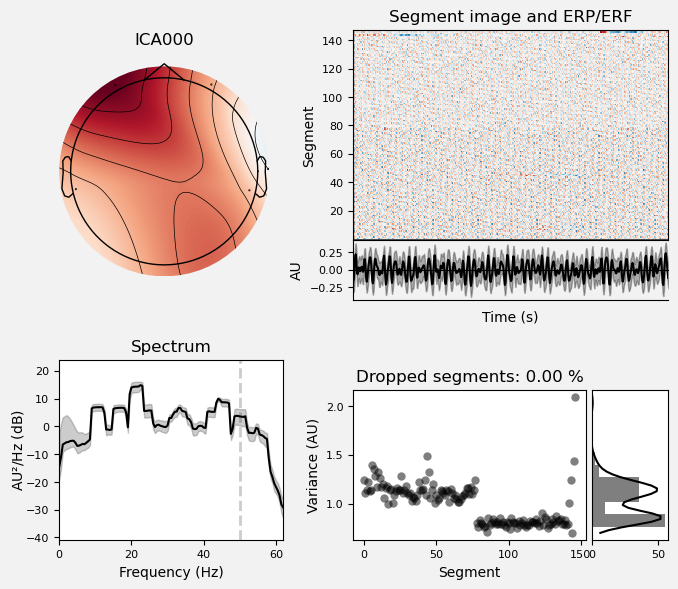

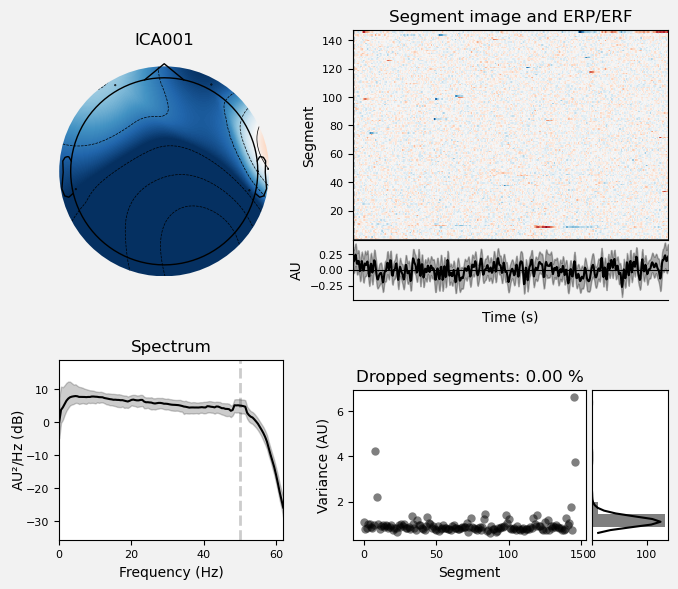

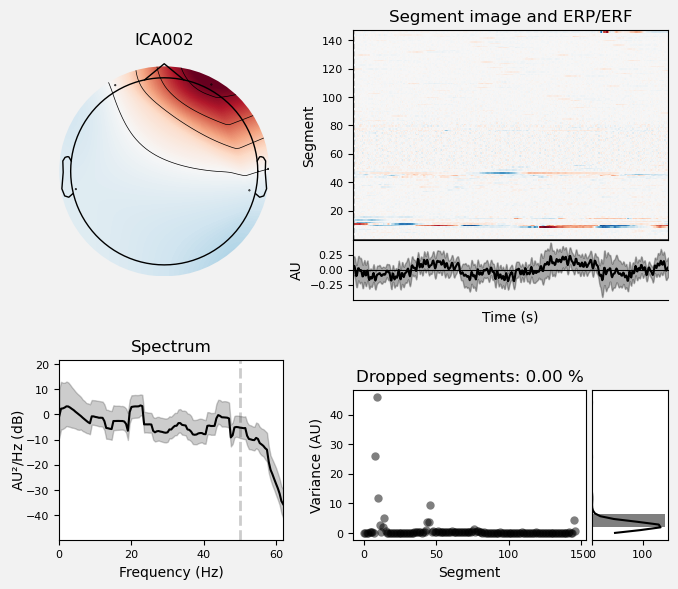

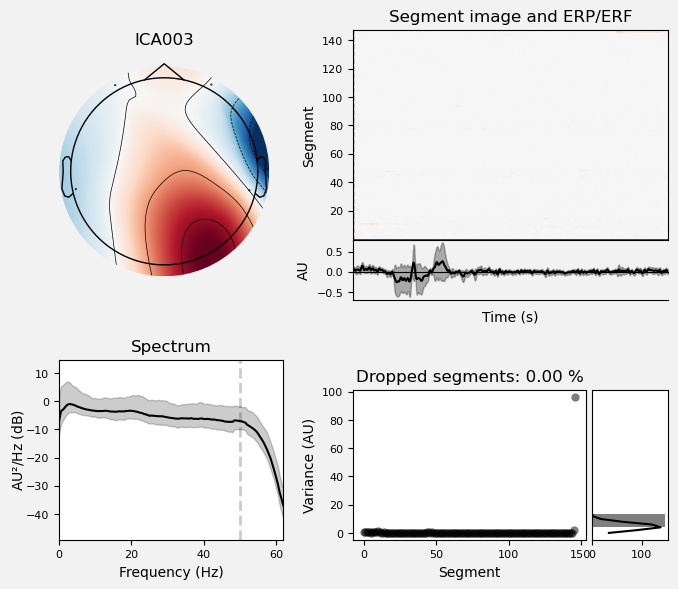

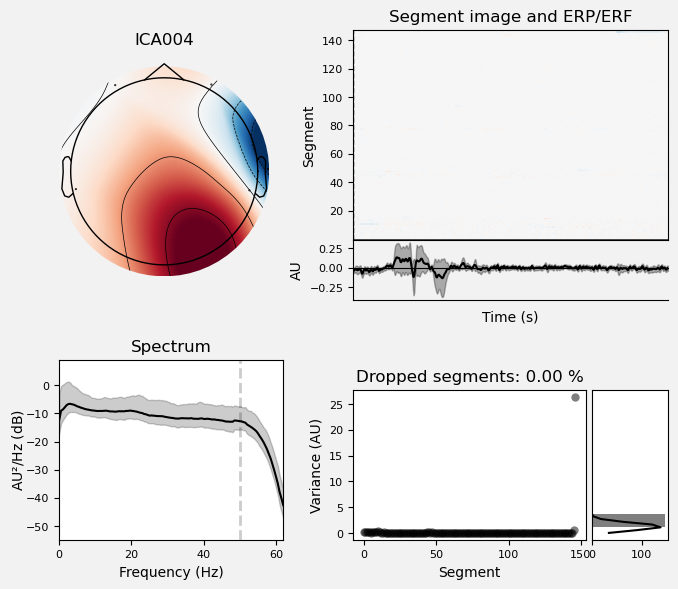


 Misha 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.1) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
162 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
162 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
162 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
162 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
162 matching events found
No baseline correction applied
0 projection items activated


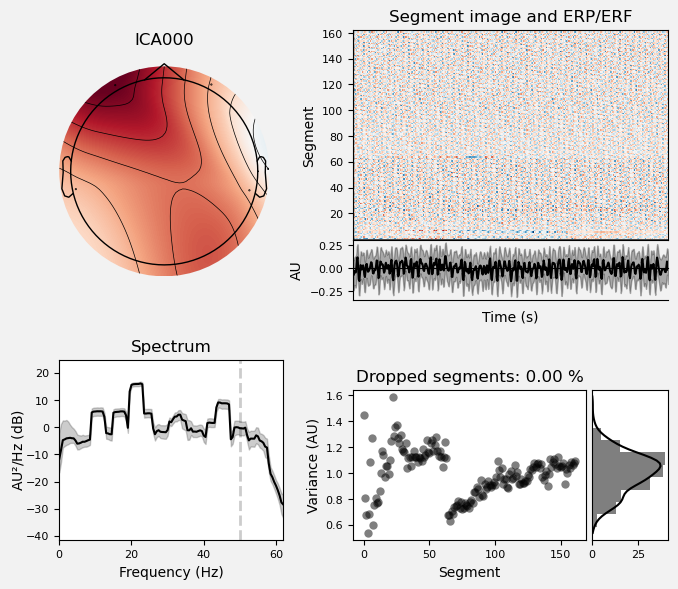

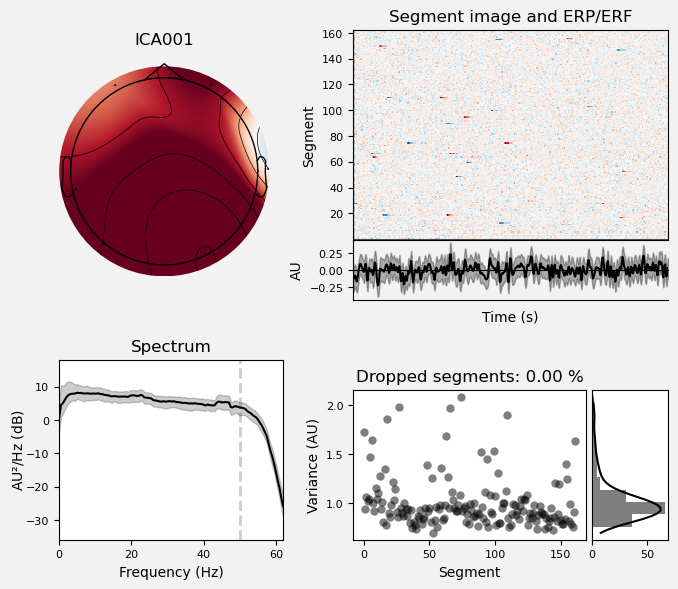

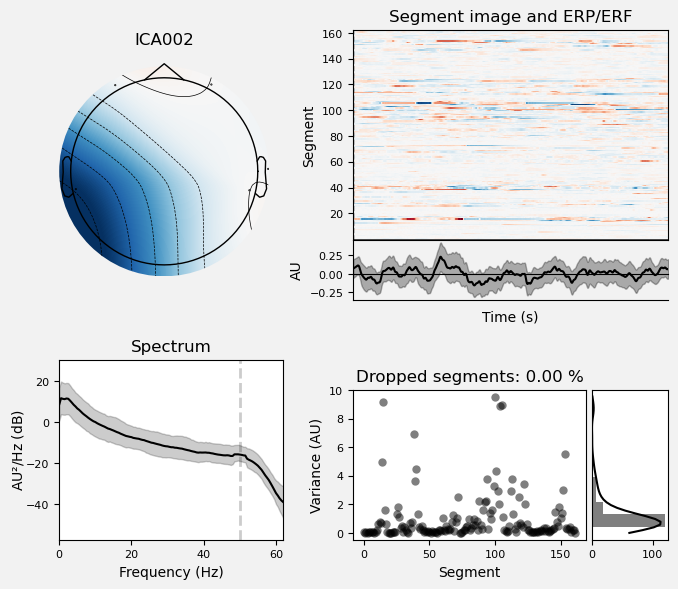

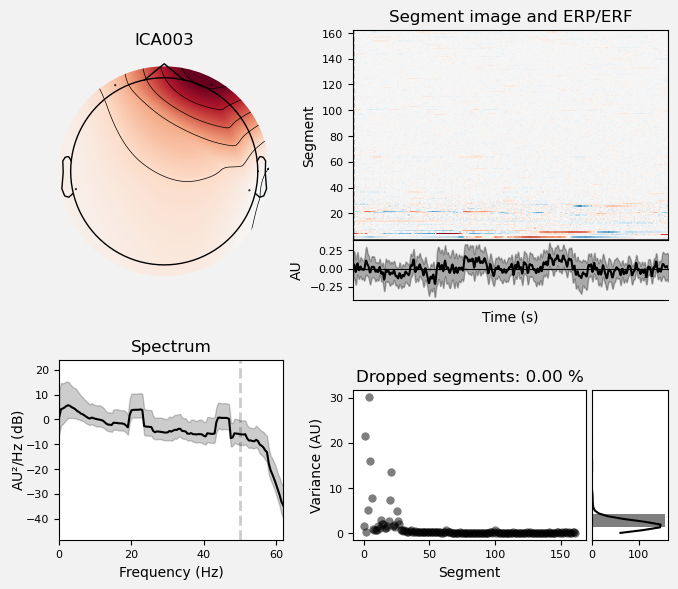

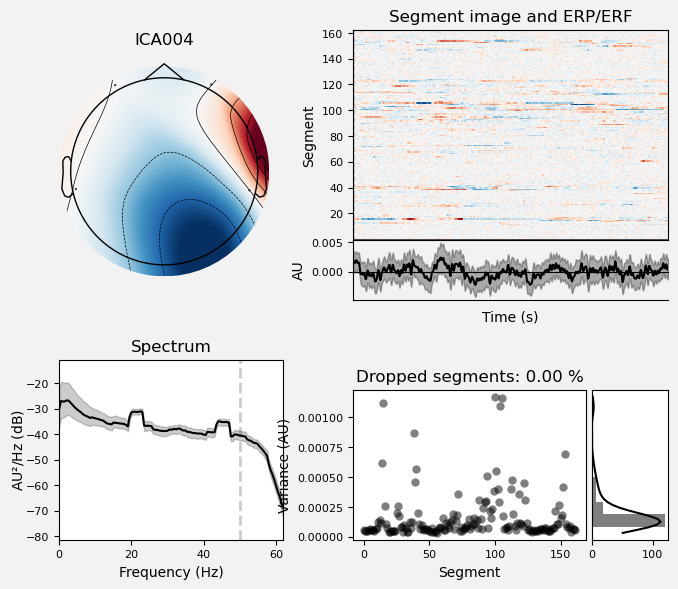


 Sasha 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.7) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated


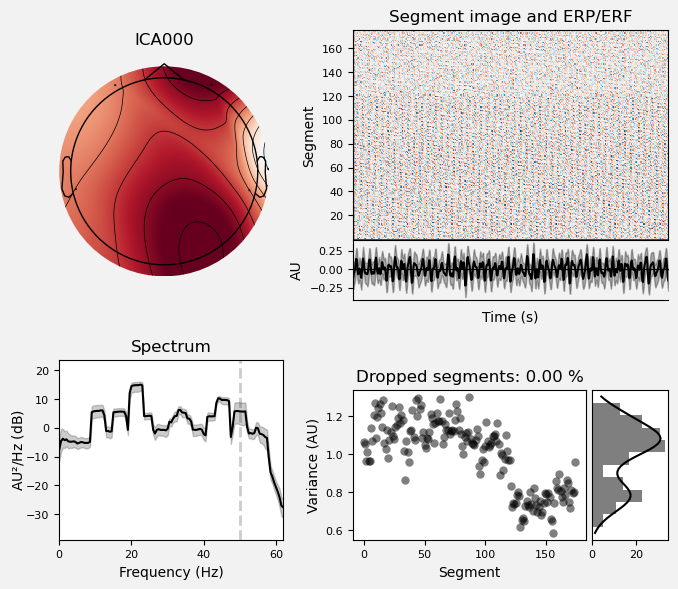

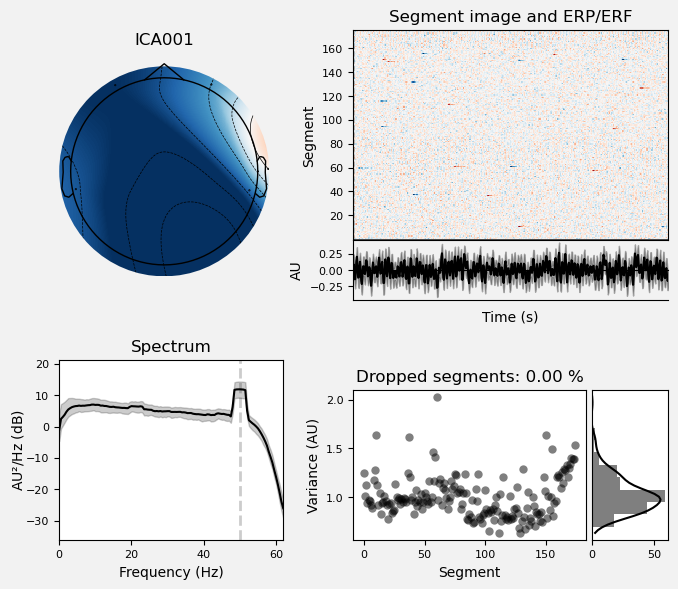

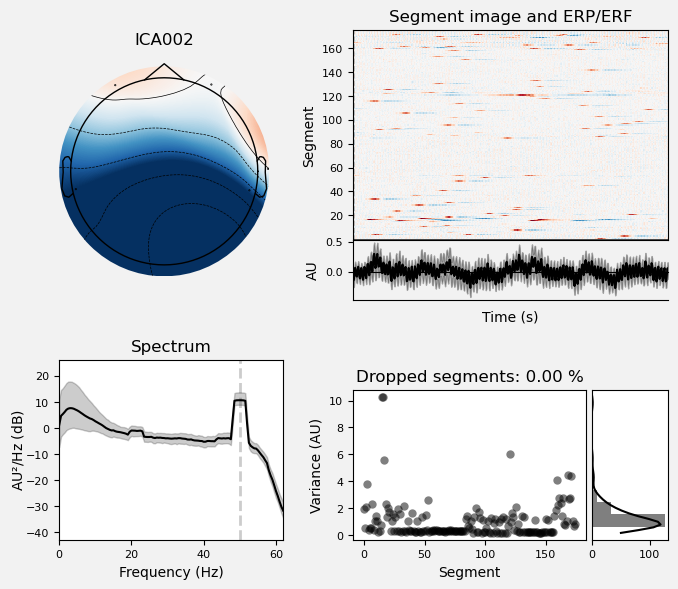

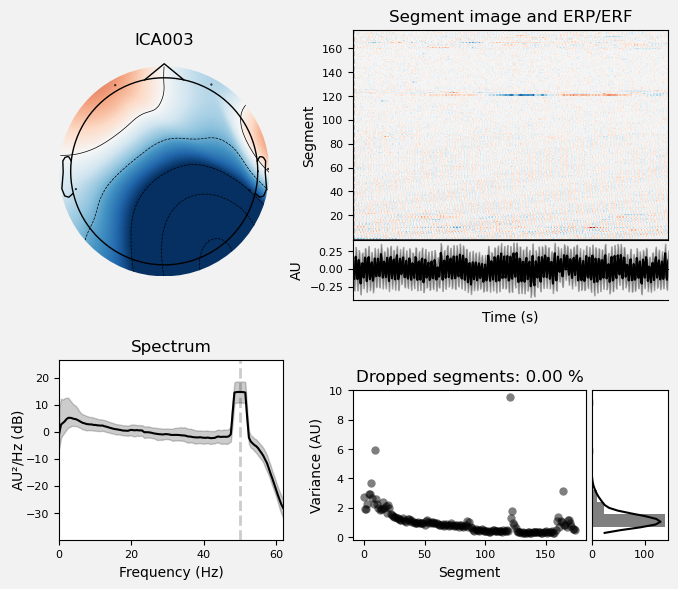

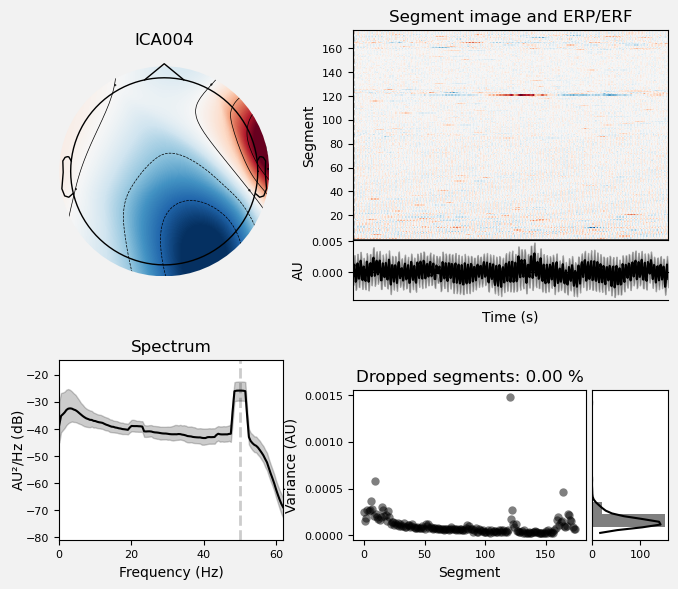


 SonyM 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.6) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
150 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
150 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
150 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
150 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
150 matching events found
No baseline correction applied
0 projection items activated


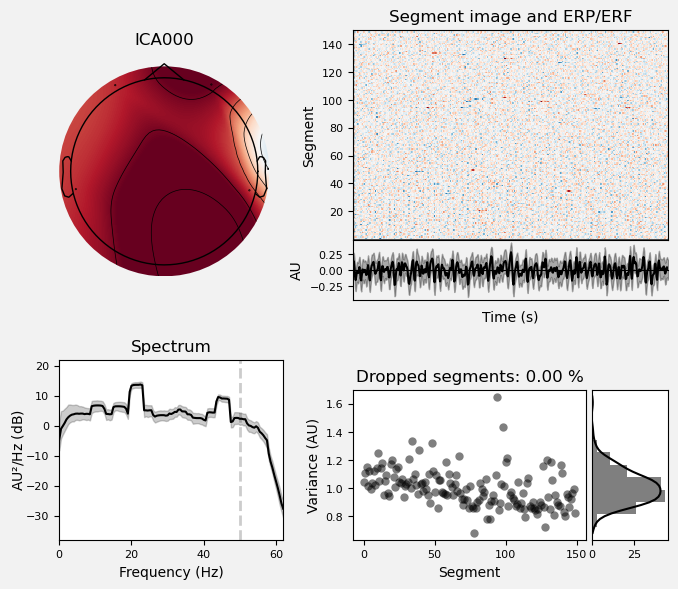

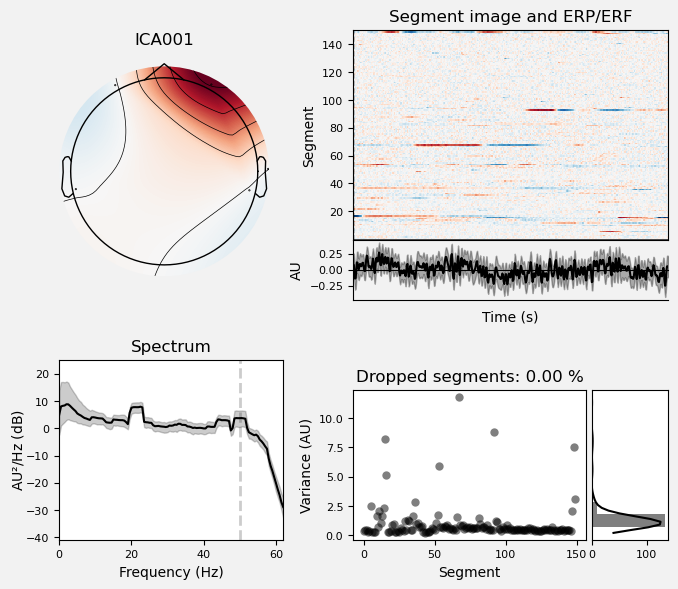

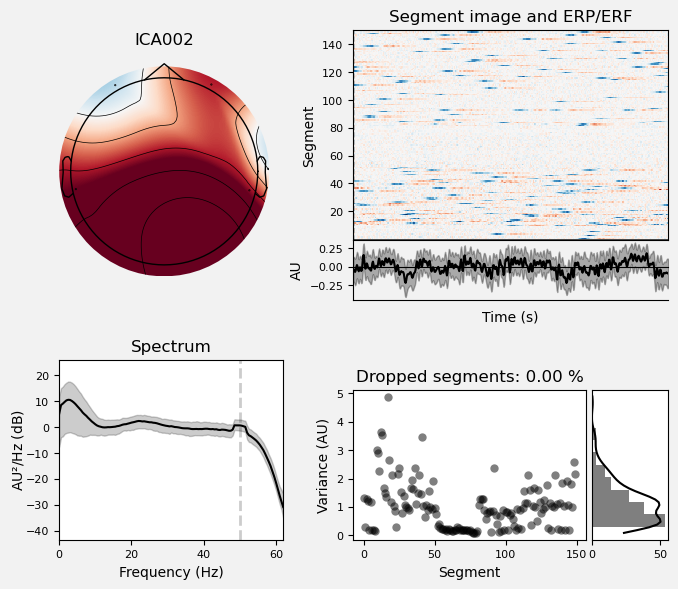

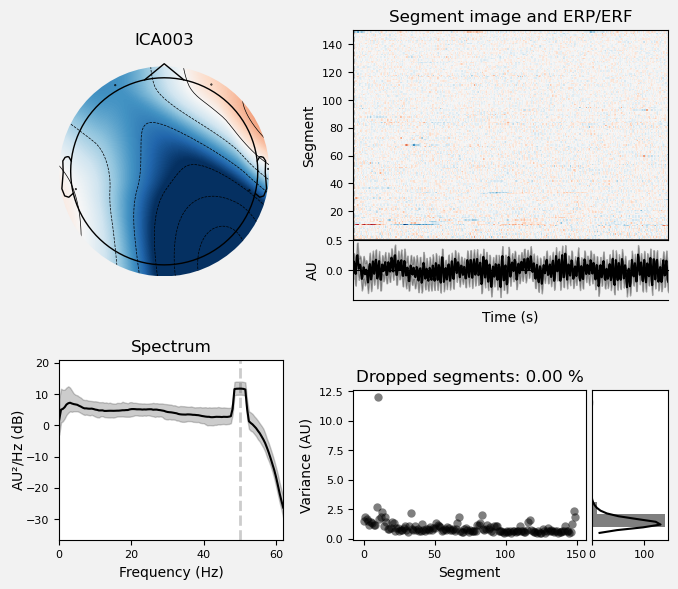

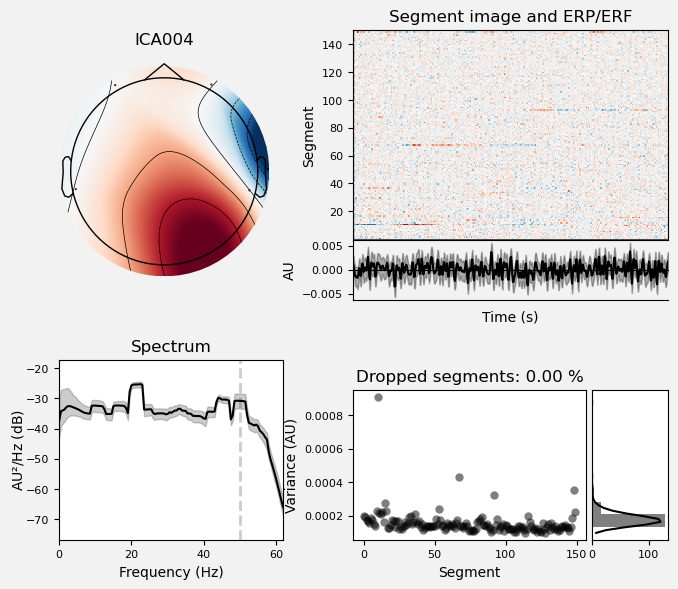


 Nasty 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.4) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
148 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
148 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
148 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
148 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
148 matching events found
No baseline correction applied
0 projection items activated


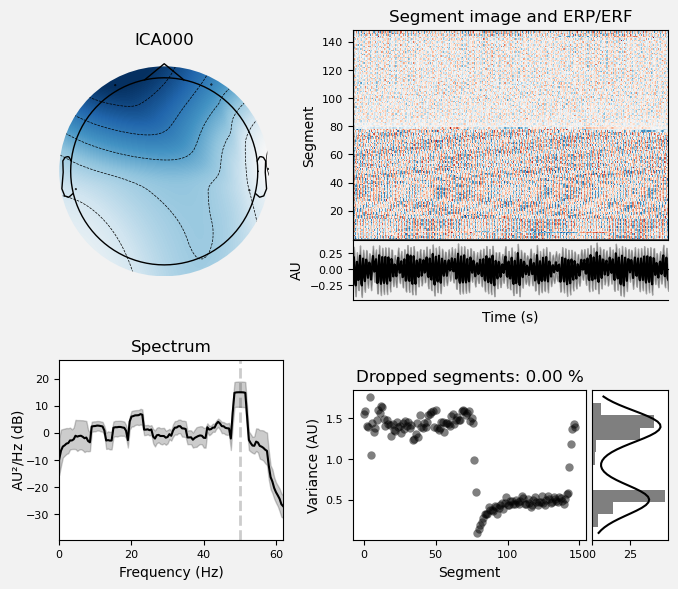

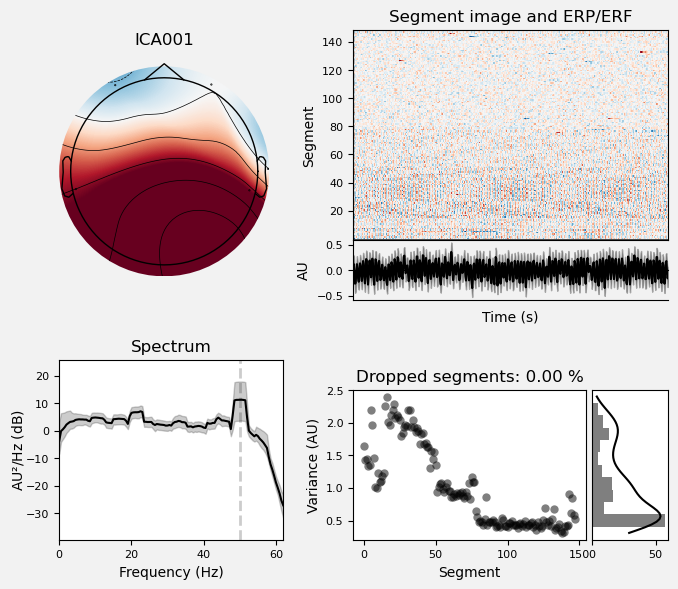

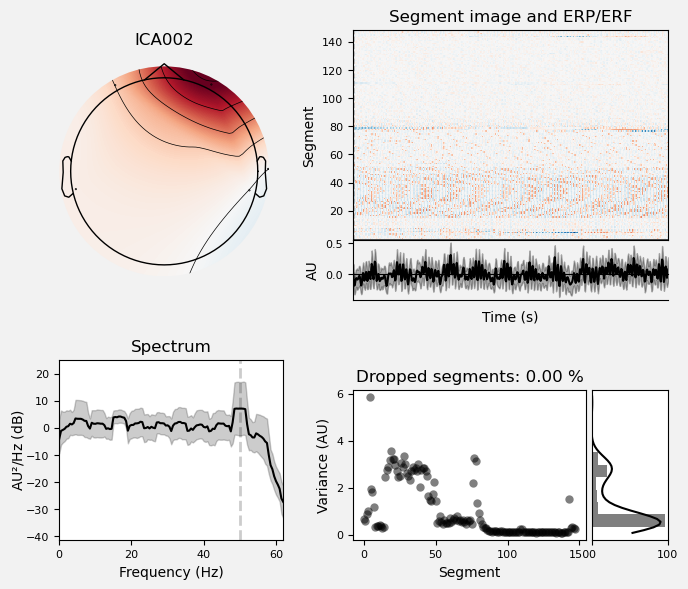

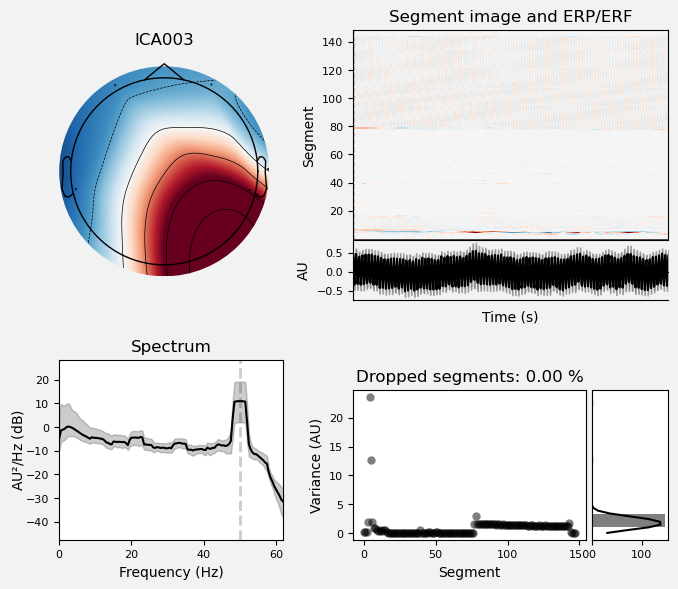

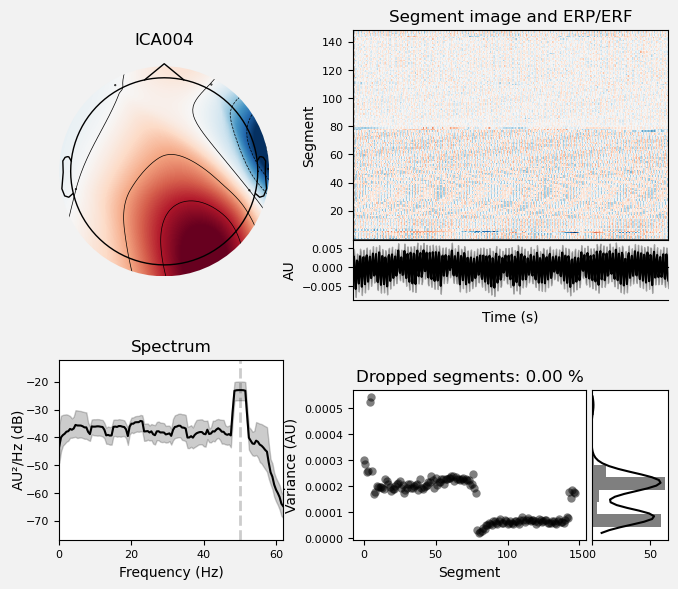


 Katya 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.5) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
175 matching events found
No baseline correction applied
0 projection items activated


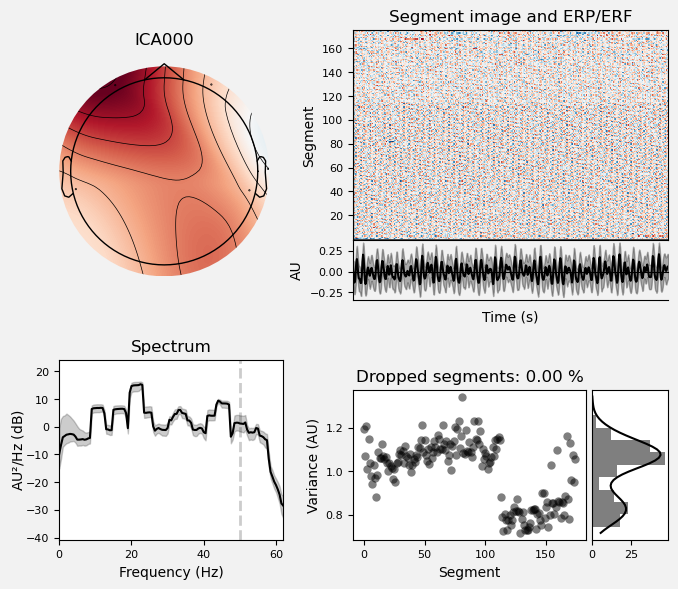

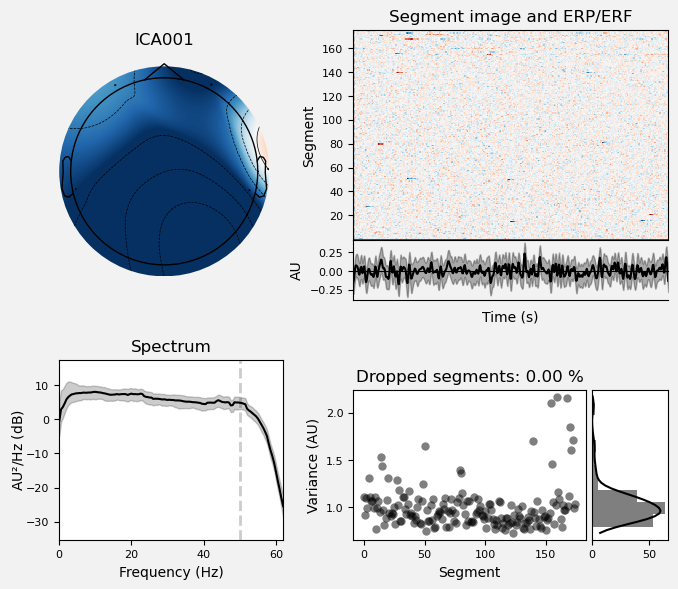

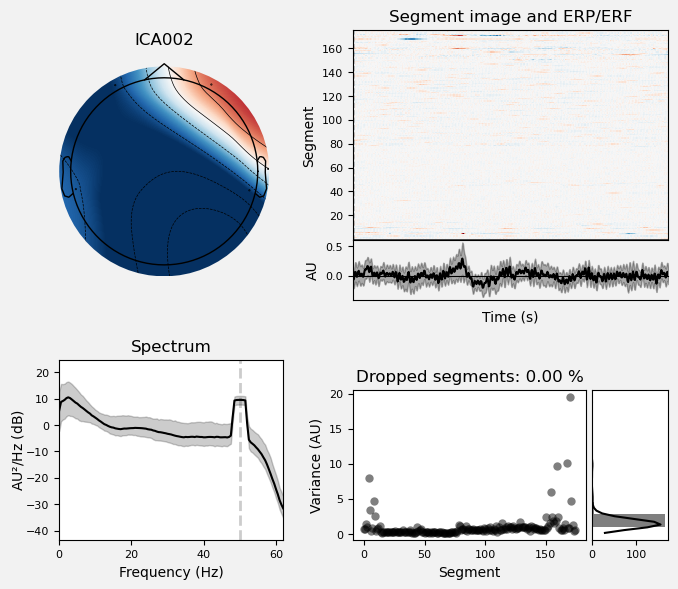

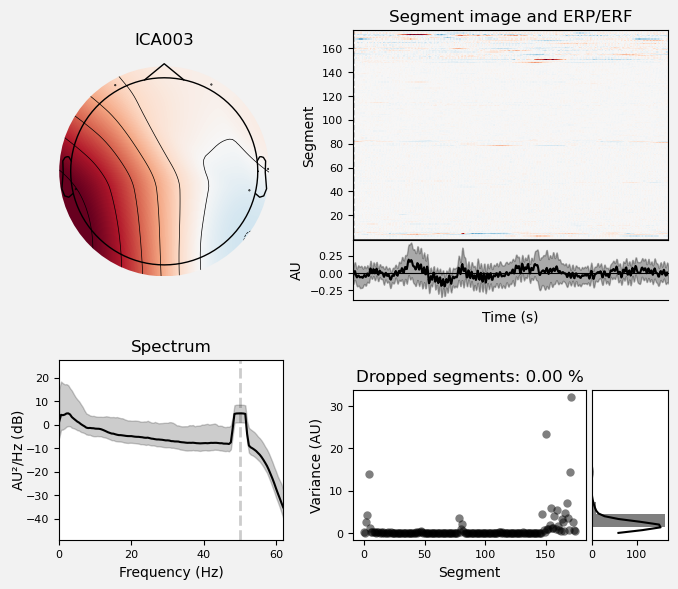

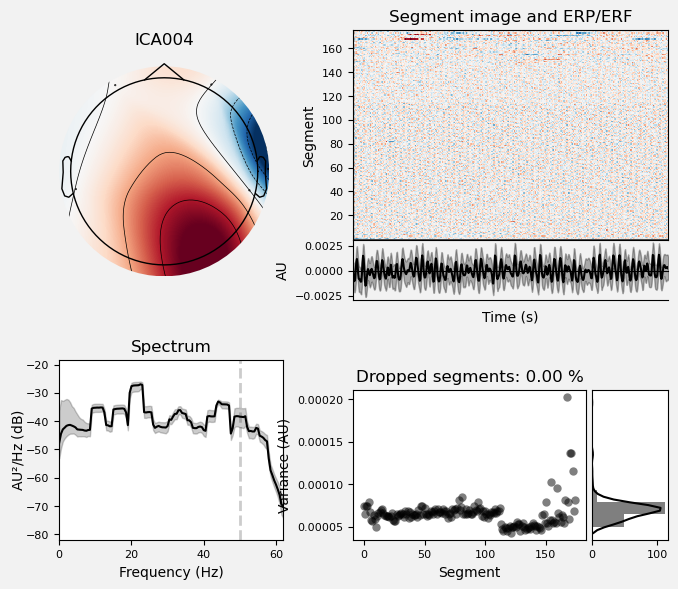


 Pilug 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.3s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.6) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
165 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
165 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
165 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
165 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
165 matching events found
No baseline correction applied
0 projection items activated


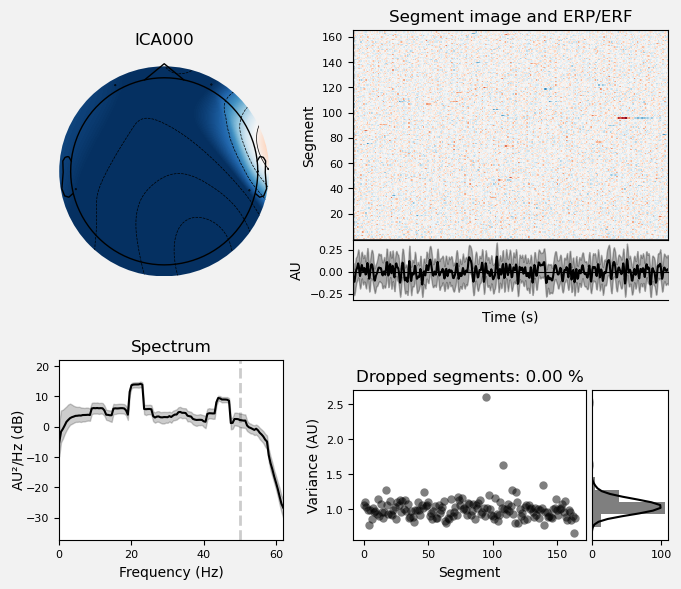

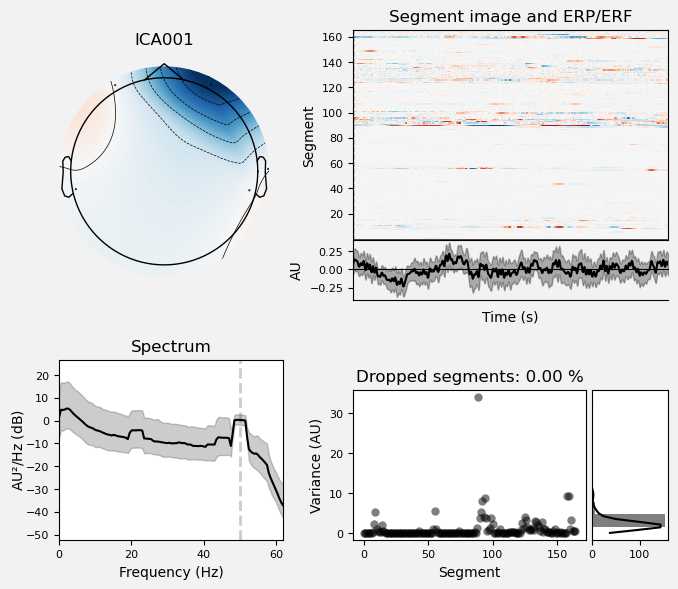

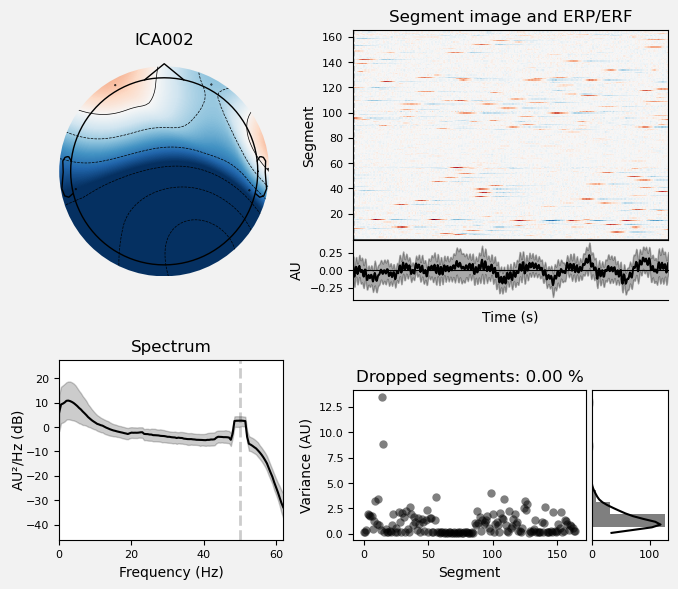

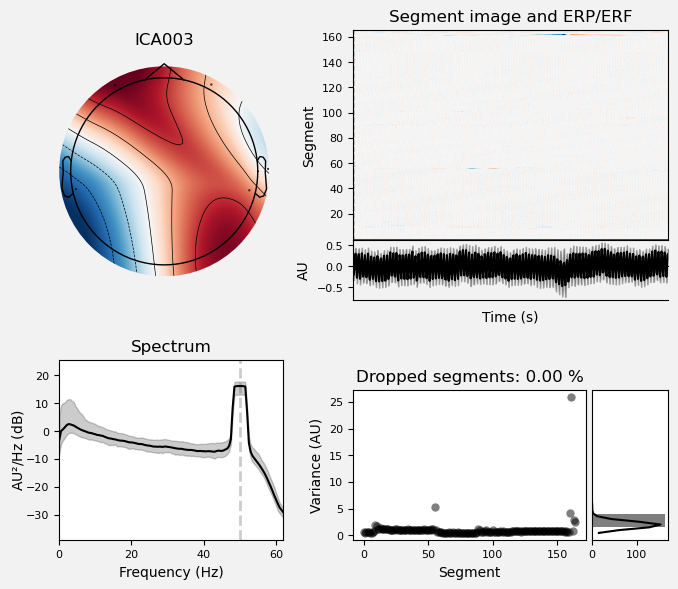

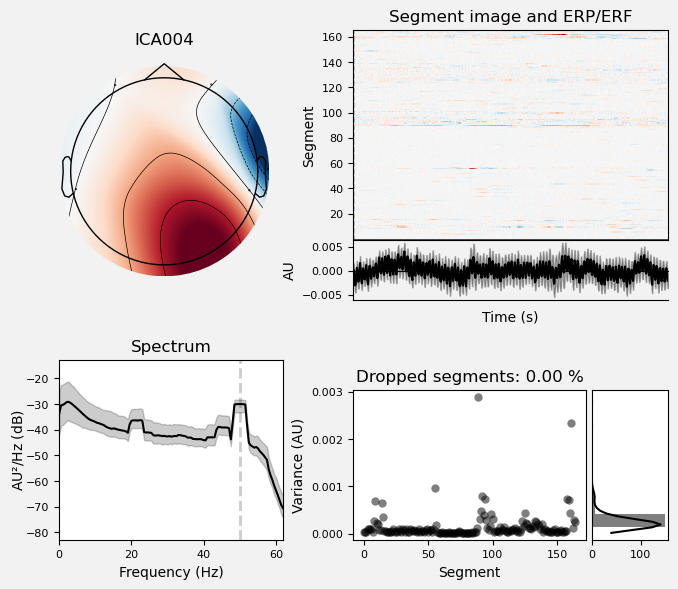


 Kurki 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.3) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
156 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
156 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
156 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
156 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
156 matching events found
No baseline correction applied
0 projection items activated


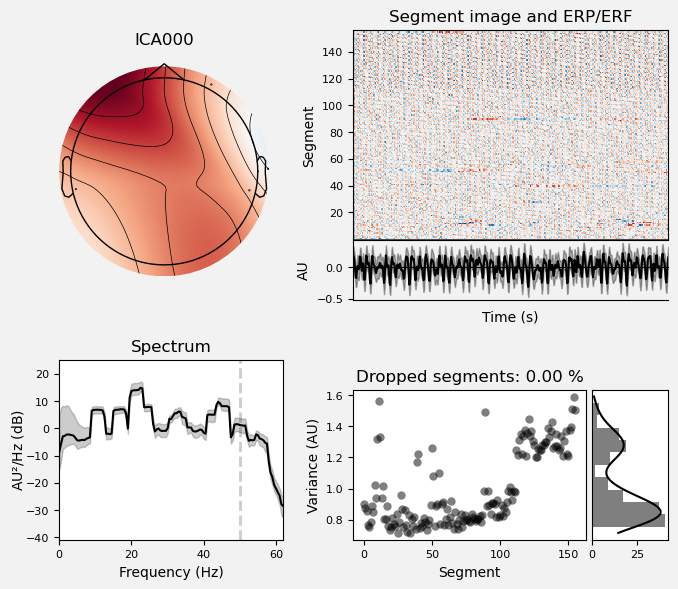

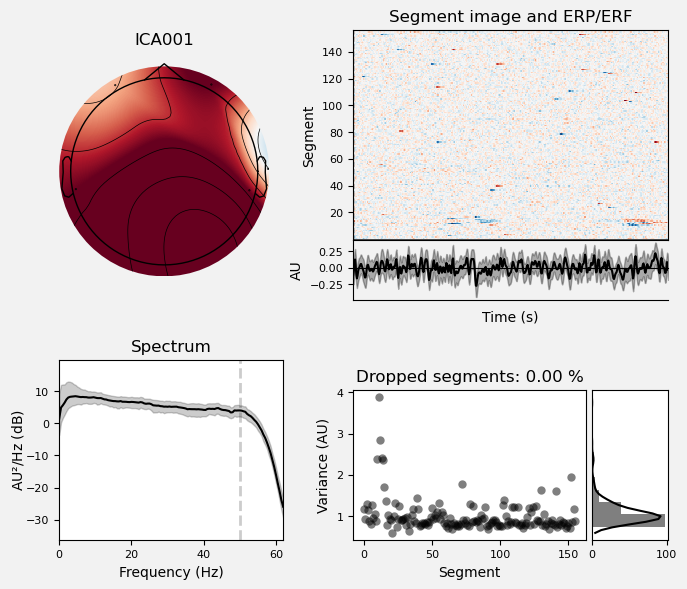

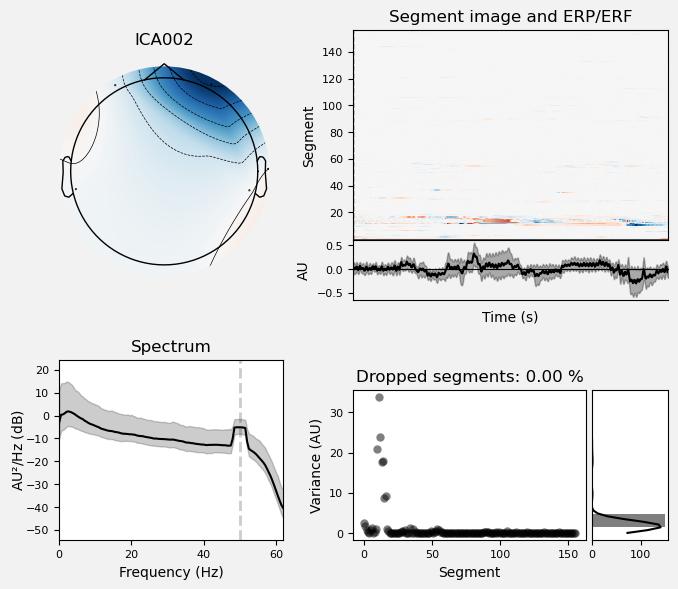

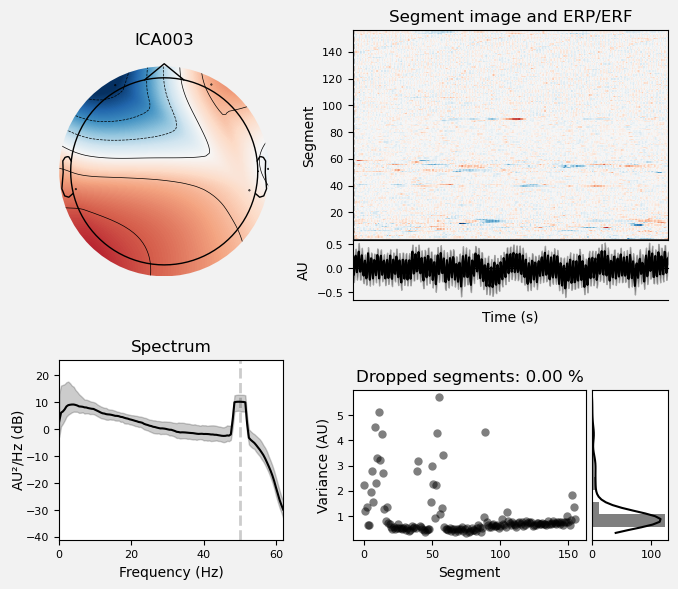

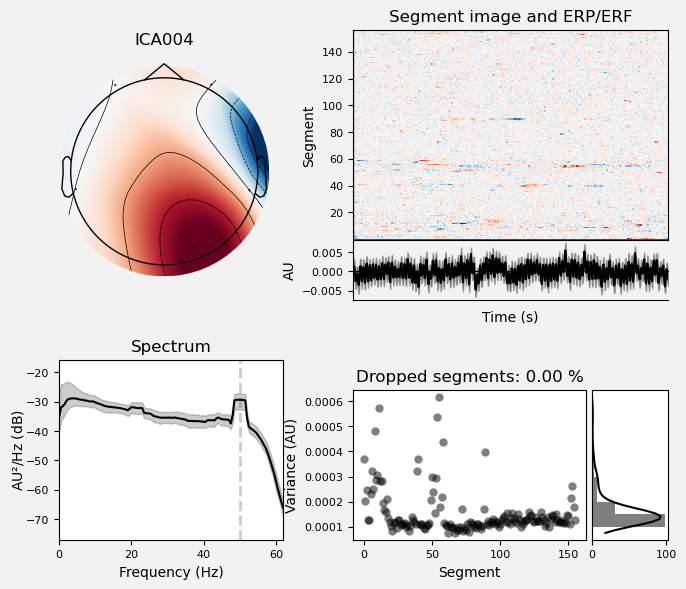


 Medve 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.5) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
154 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
154 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
154 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
154 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
154 matching events found
No baseline correction applied
0 projection items activated


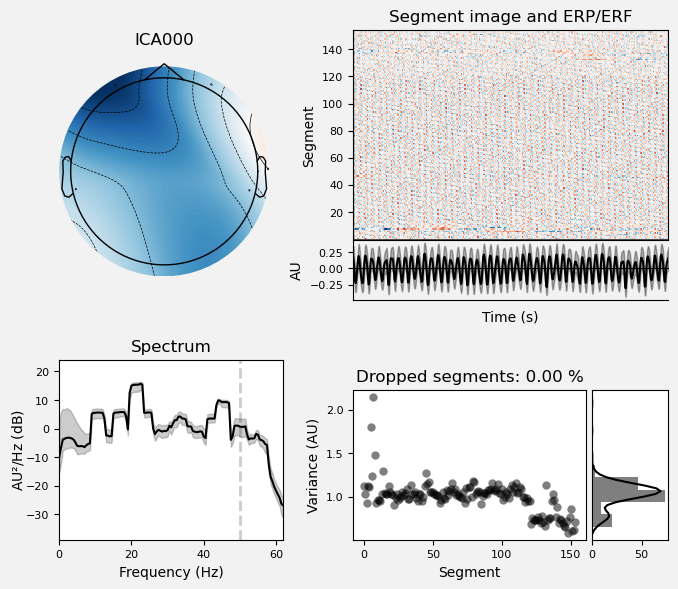

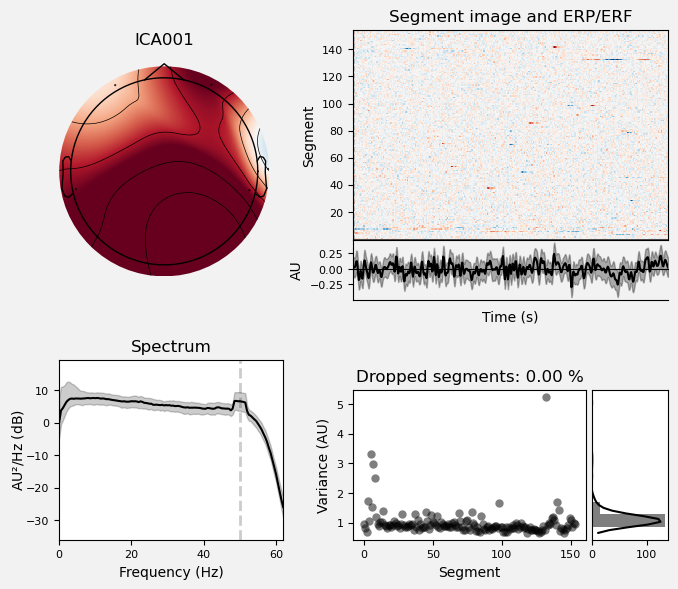

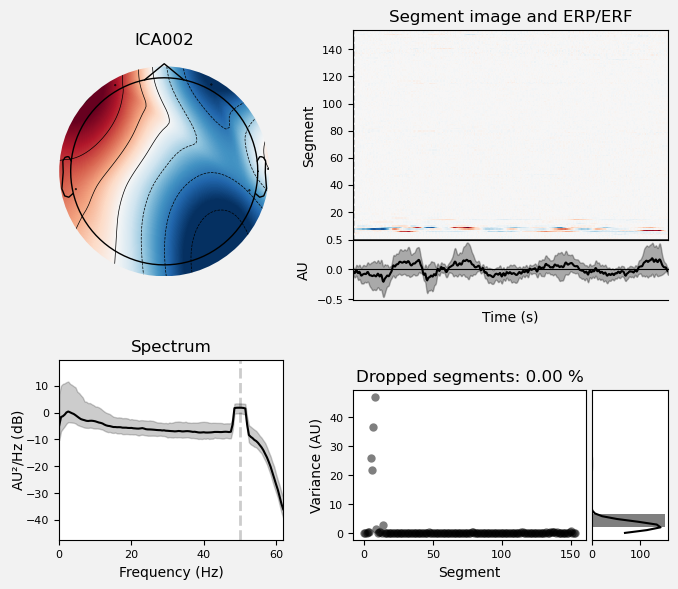

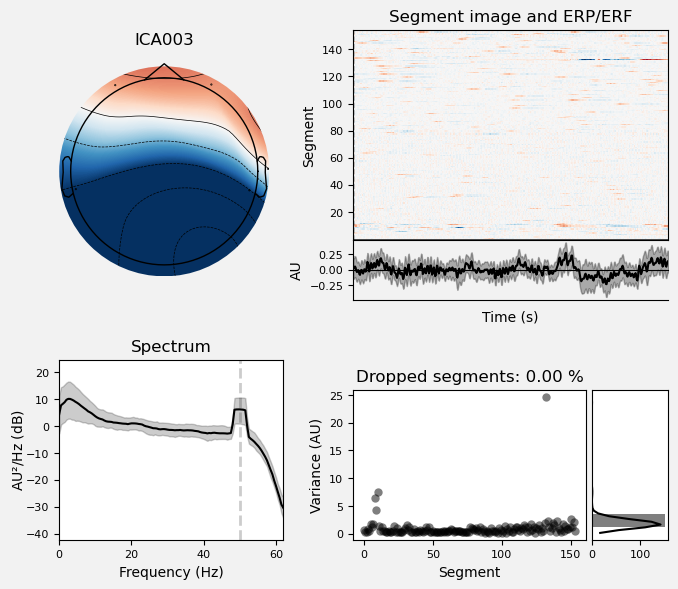

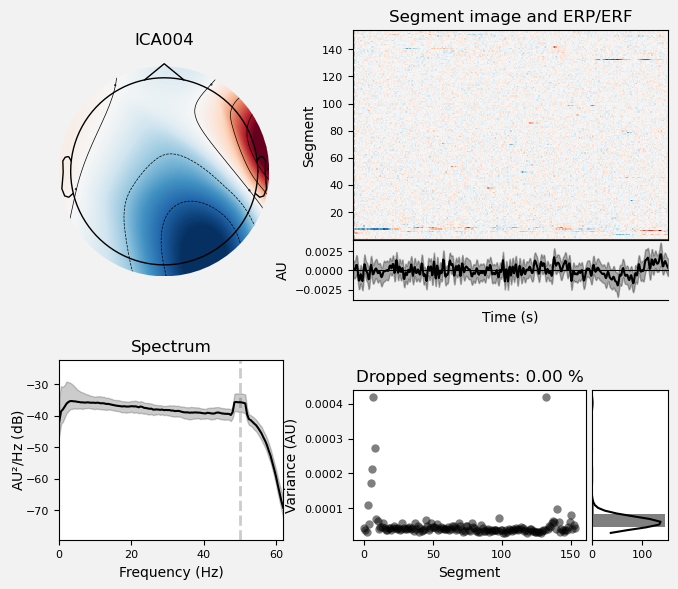


 Koblo 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.3) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
159 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
159 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
159 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
159 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
159 matching events found
No baseline correction applied
0 projection items activated


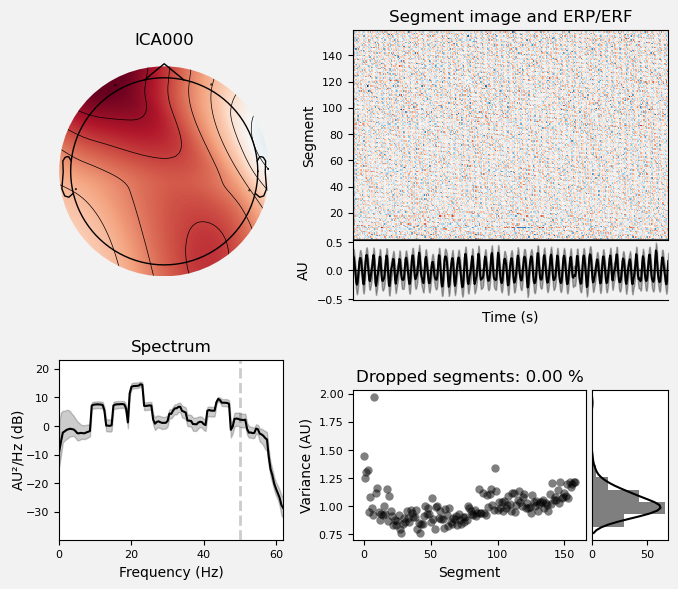

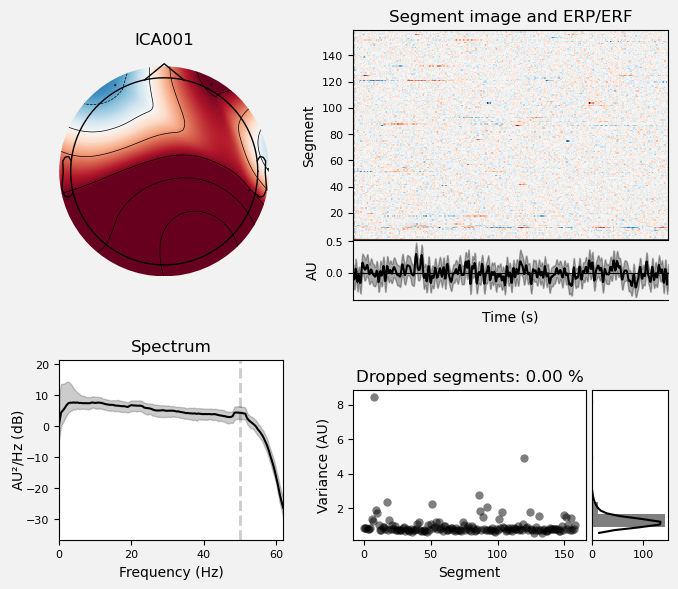

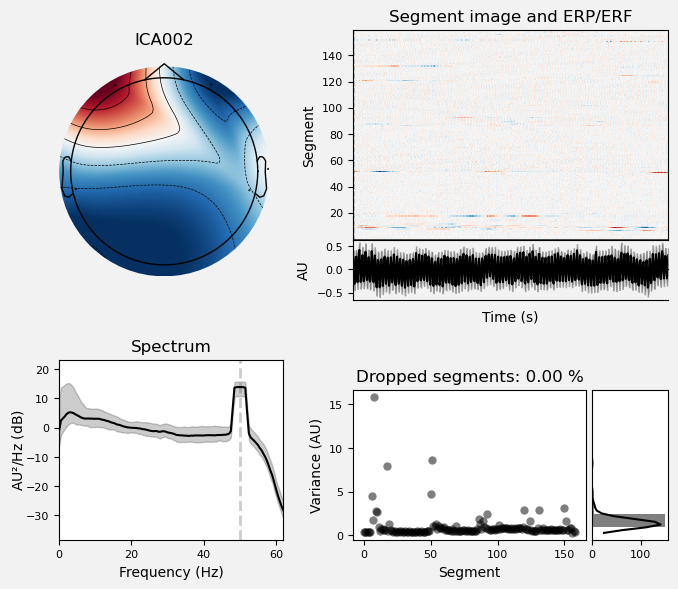

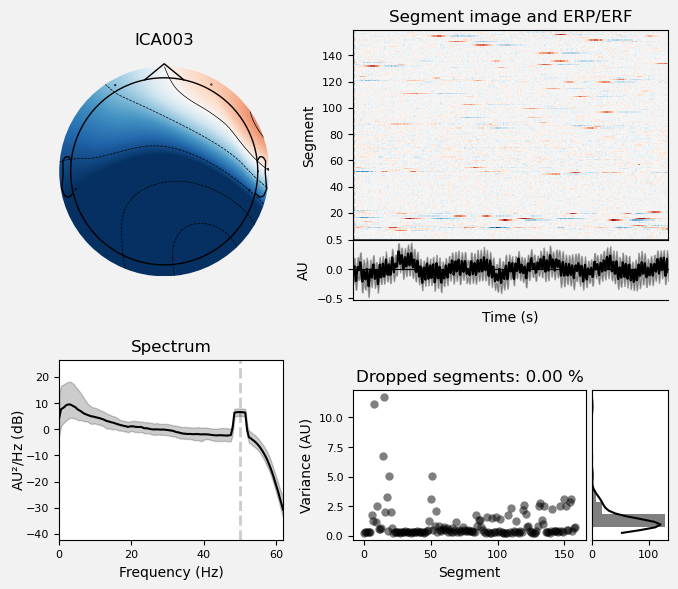

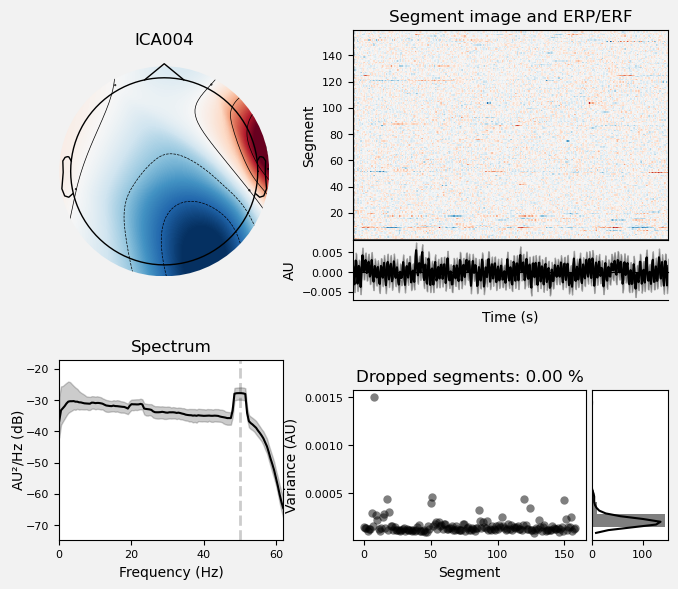


 Balts 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.3) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
166 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
166 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
166 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
166 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
166 matching events found
No baseline correction applied
0 projection items activated


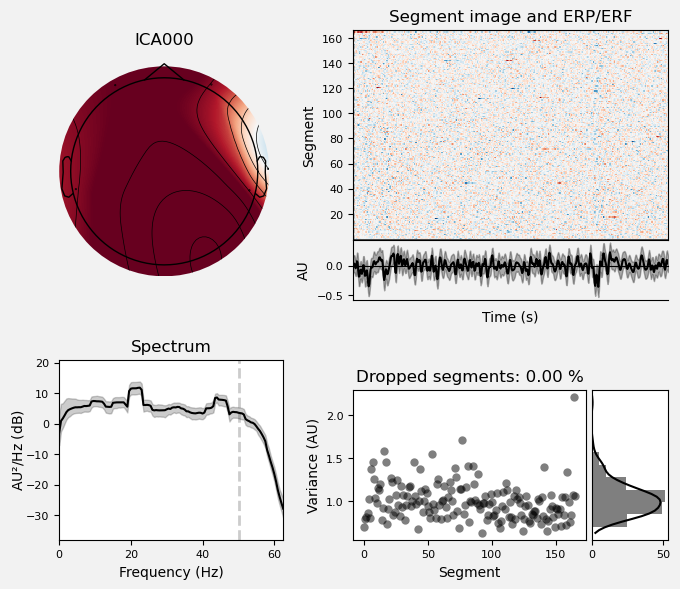

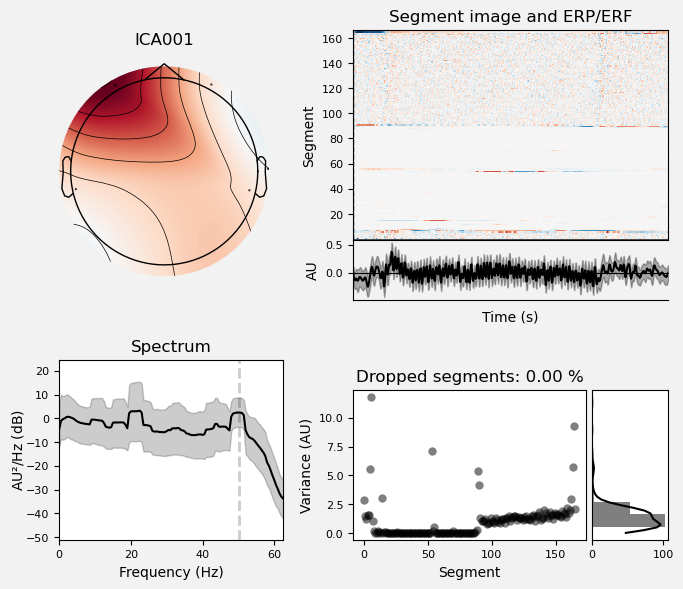

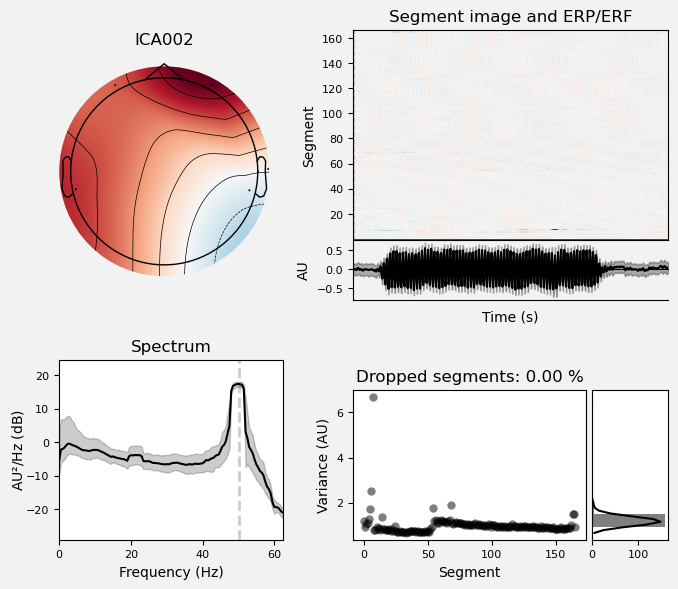

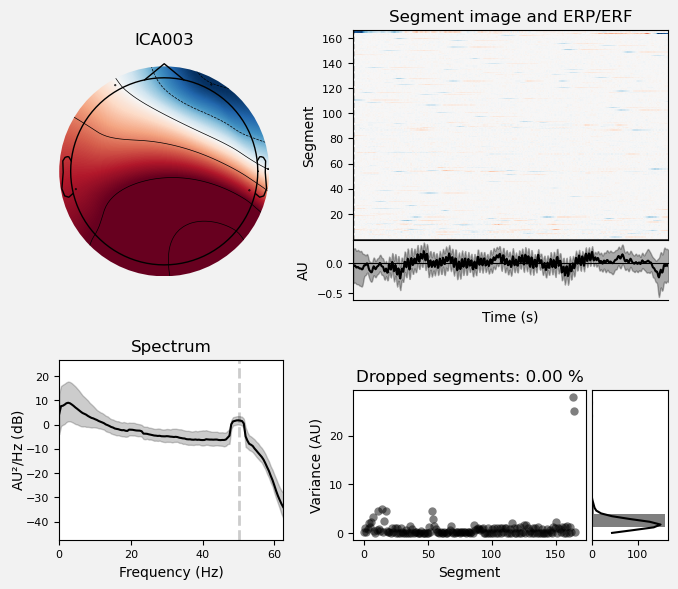

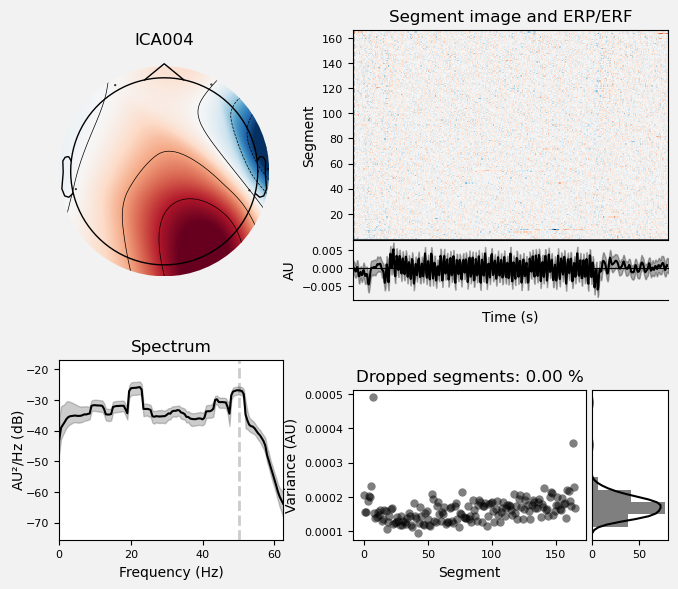


 Dolgi 

Fitting ICA to data using 5 channels (please be patient, this may take a while)
Selecting by number: 5 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\2409581347.py:6: RuntimeWarning: Using n_components=5 (resulting in n_components_=5) may lead to an unstable mixing matrix estimation because the ratio between the largest (4.5) and smallest (0) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 4
  ica.fit(raw, picks='all')


Not setting metadata
153 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
153 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
153 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
153 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
153 matching events found
No baseline correction applied
0 projection items activated


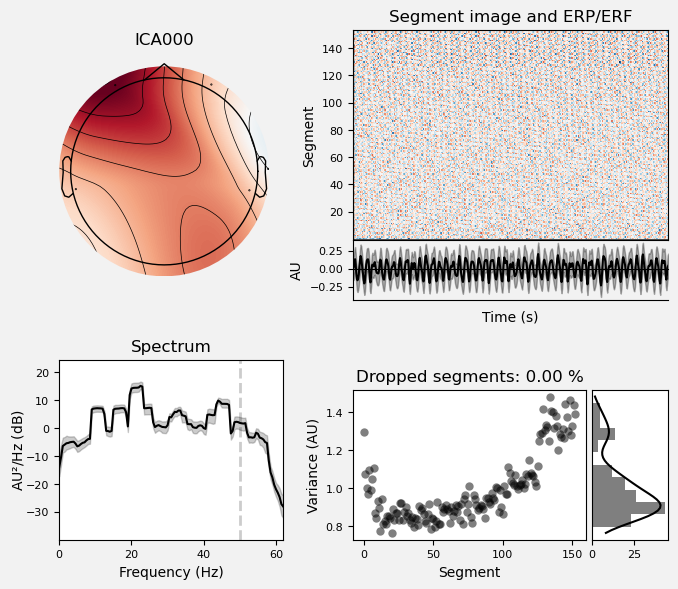

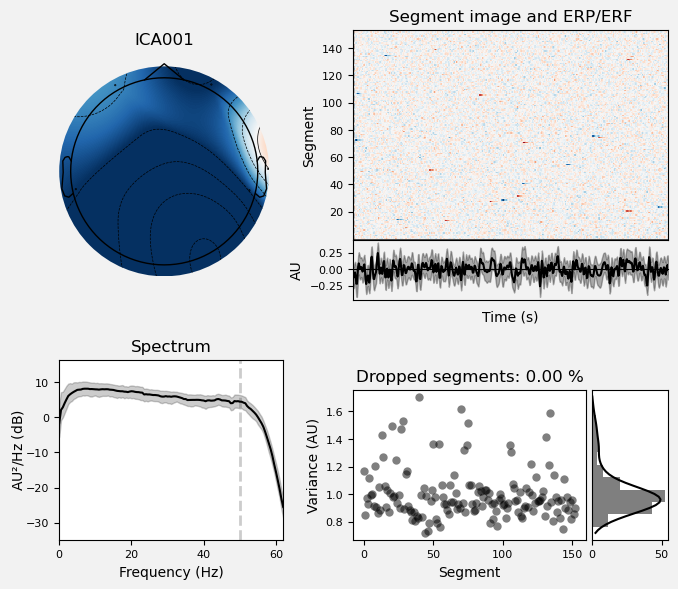

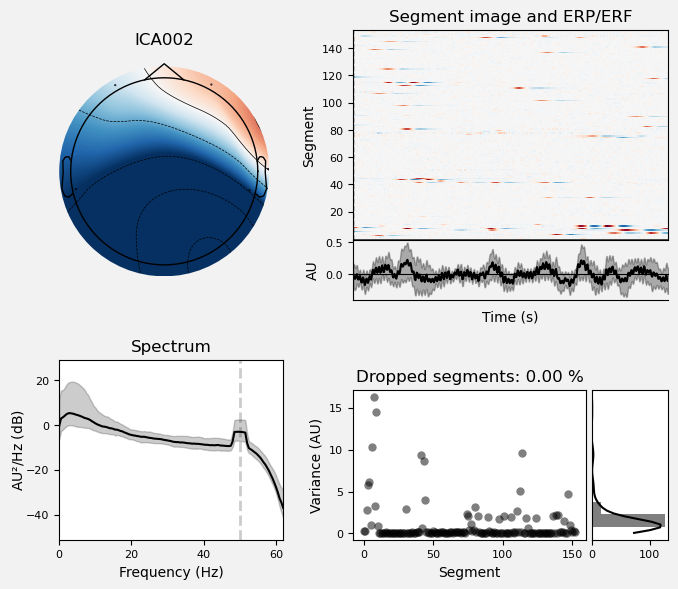

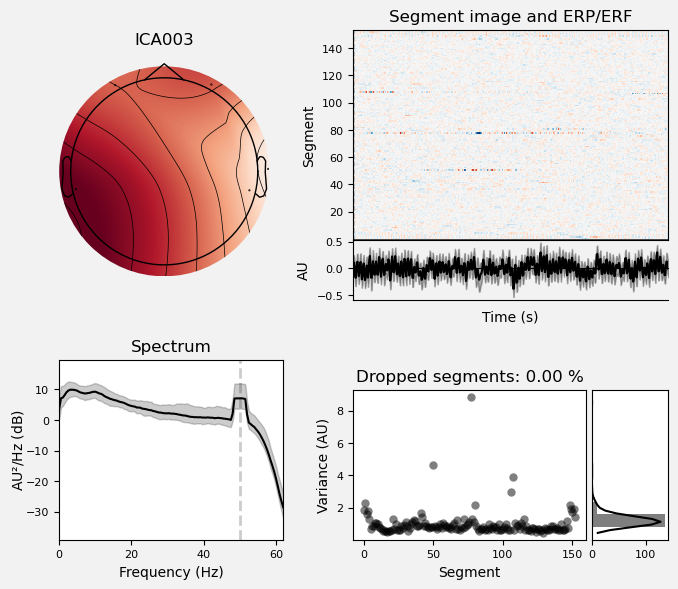

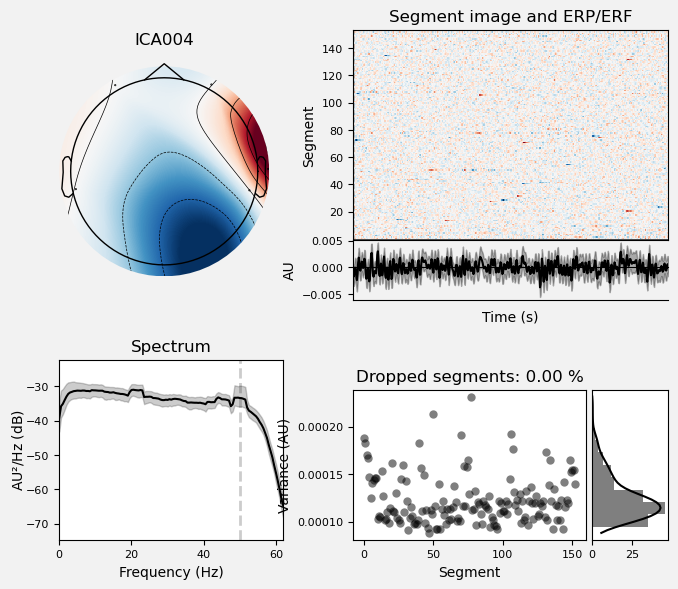


 Mozgo 

Fitting ICA to data using 5 channels (please be patient, this may take a while)


ValueError: array must not contain infs or NaNs

In [11]:
for i in names:
    print('\n', i, '\n')
    # set up and fit the ICA
    raw = raw_list[i]
    ica = mne.preprocessing.ICA(n_components=5, random_state=97, max_iter=800)
    ica.fit(raw, picks='all')
    ica.plot_properties(raw, picks=[0,1,2,3,4])


 Alice 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
148 matching events found
No baseline correction applied
0 projection items activated


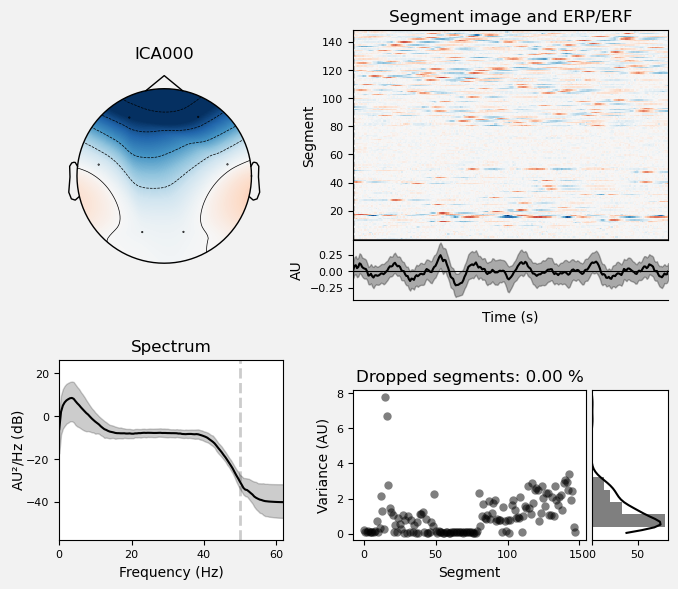

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Almaz 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.1s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
170 matching events found
No baseline correction applied
0 projection items activated


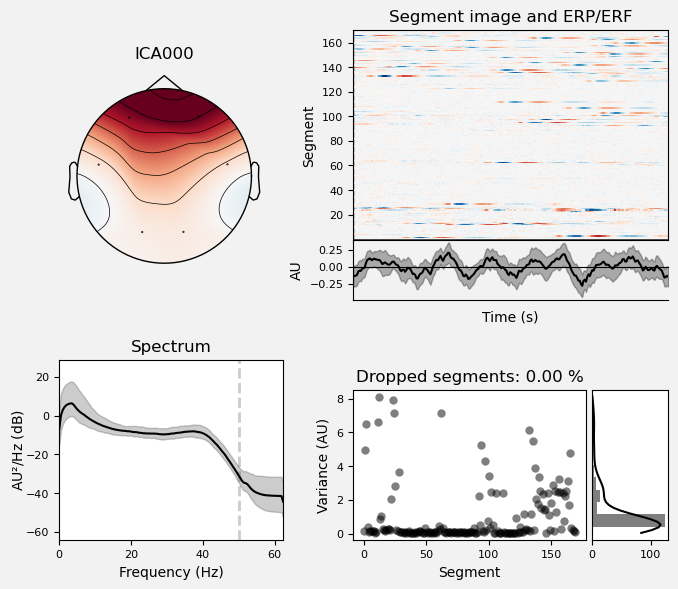

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Misha 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.3s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
187 matching events found
No baseline correction applied
0 projection items activated


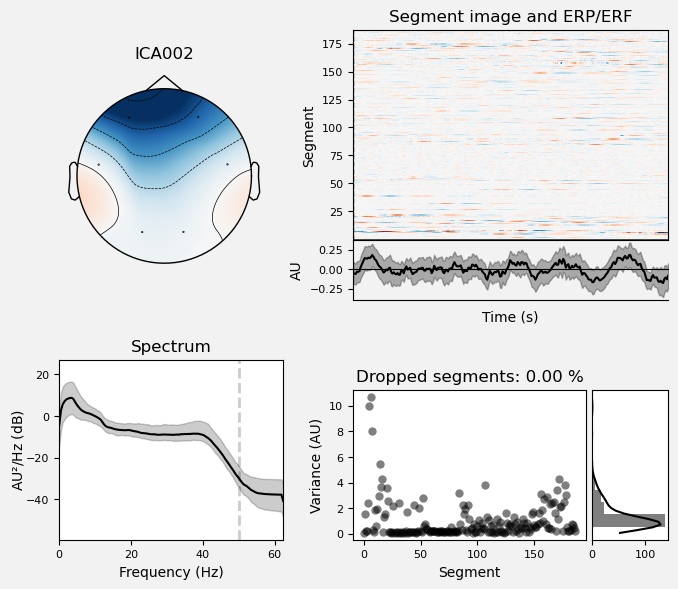

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Sasha 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.1s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
146 matching events found
No baseline correction applied
0 projection items activated


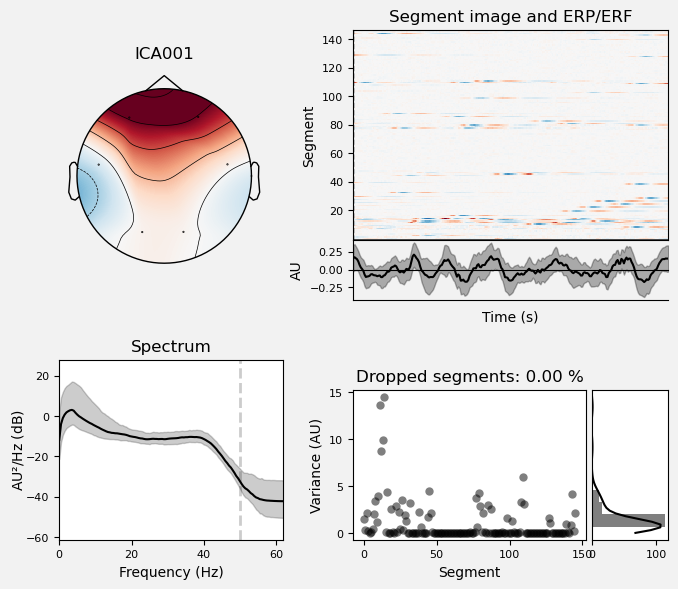

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 SonyN 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.1s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
151 matching events found
No baseline correction applied
0 projection items activated


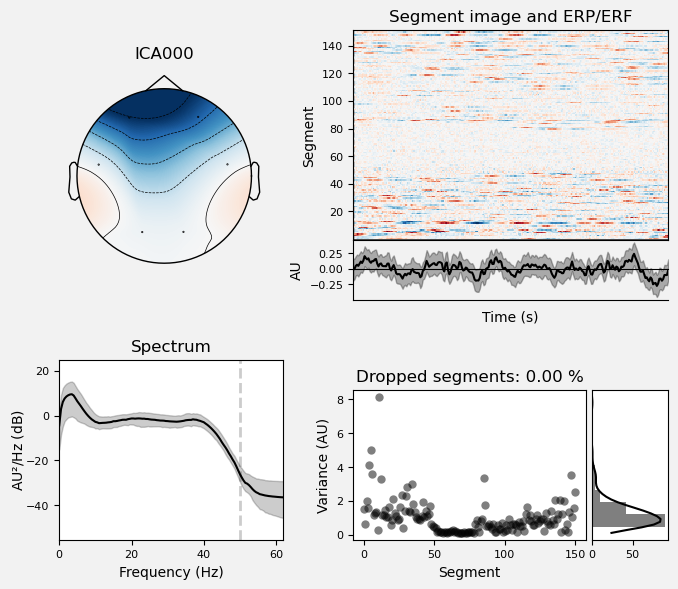

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Nasty 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.1s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
179 matching events found
No baseline correction applied
0 projection items activated


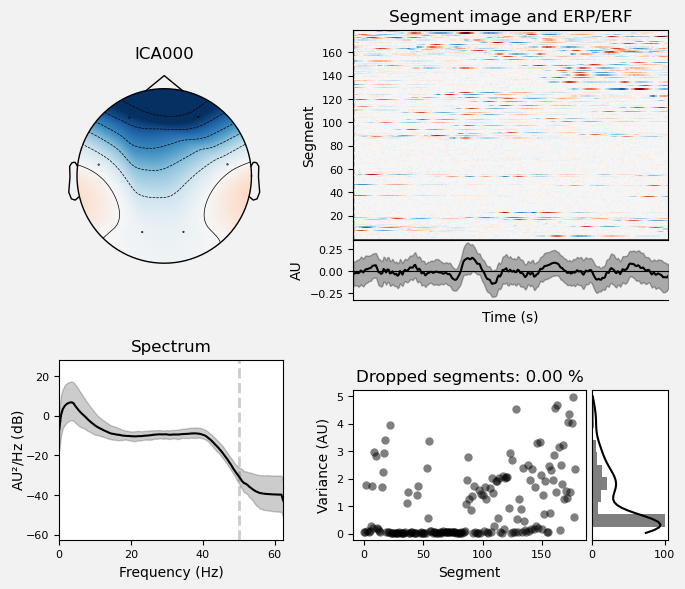

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Katya 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
170 matching events found
No baseline correction applied
0 projection items activated


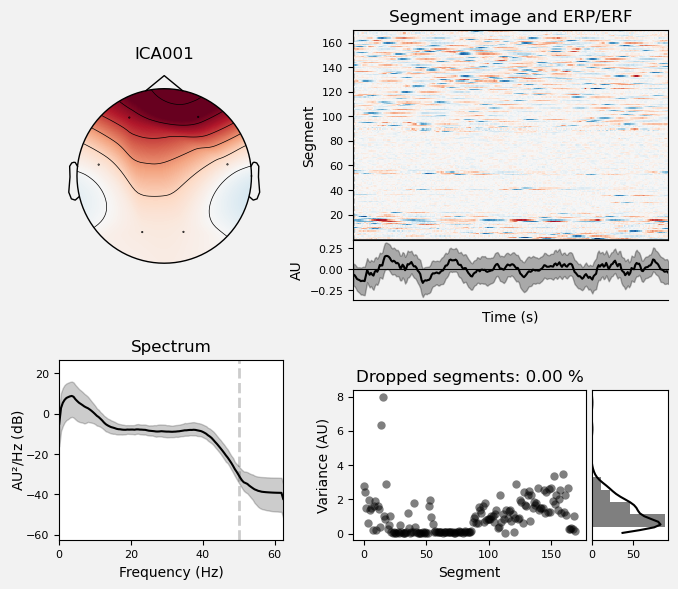

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Pilug 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.1s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
170 matching events found
No baseline correction applied
0 projection items activated


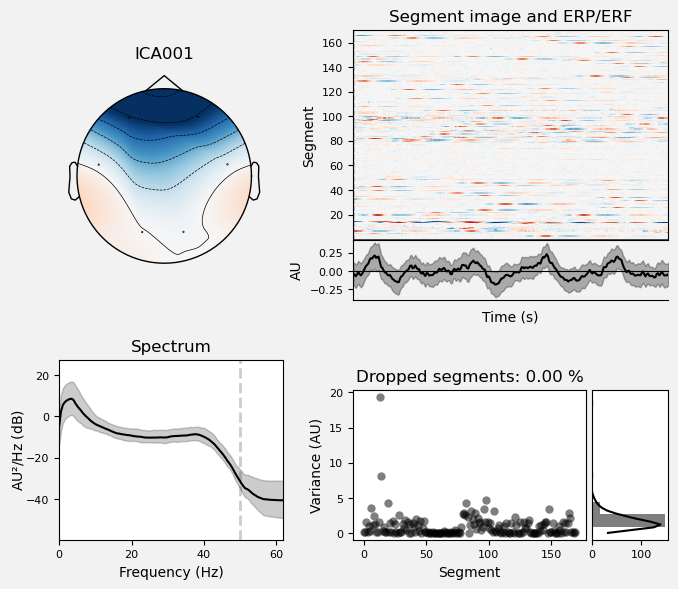

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Kurki 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
159 matching events found
No baseline correction applied
0 projection items activated


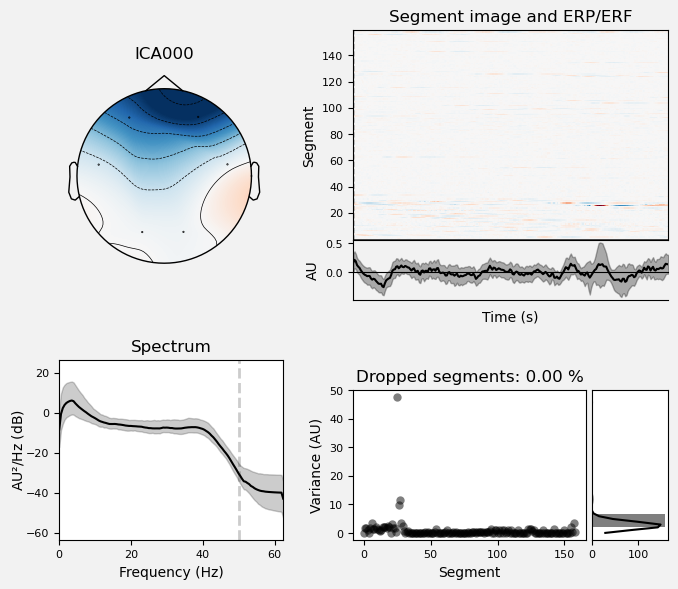

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Koblo 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.1s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
161 matching events found
No baseline correction applied
0 projection items activated


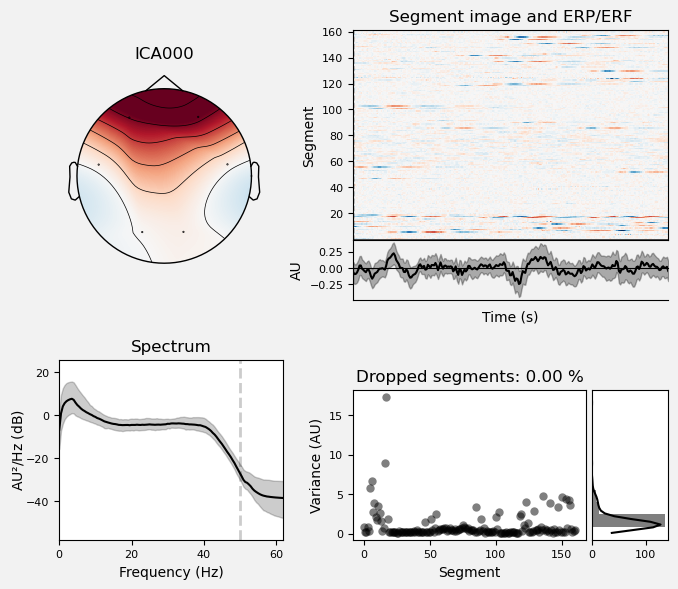

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Balts 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.1s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
150 matching events found
No baseline correction applied
0 projection items activated


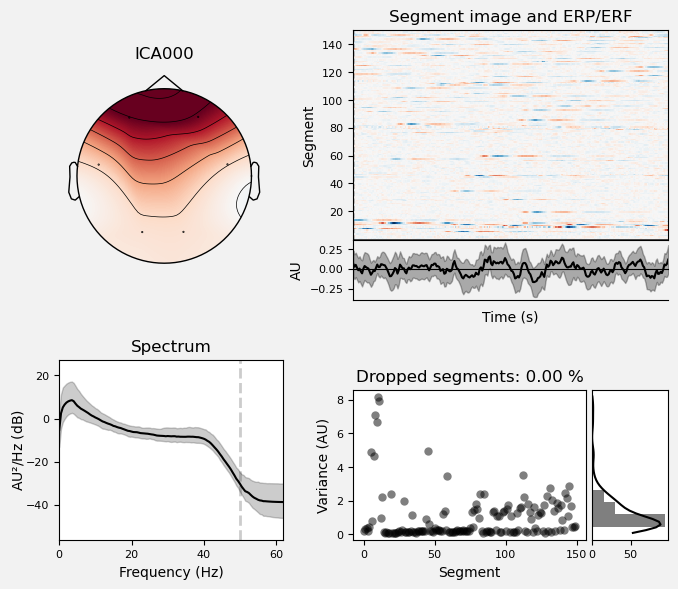

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Dolgi 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.2s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
157 matching events found
No baseline correction applied
0 projection items activated


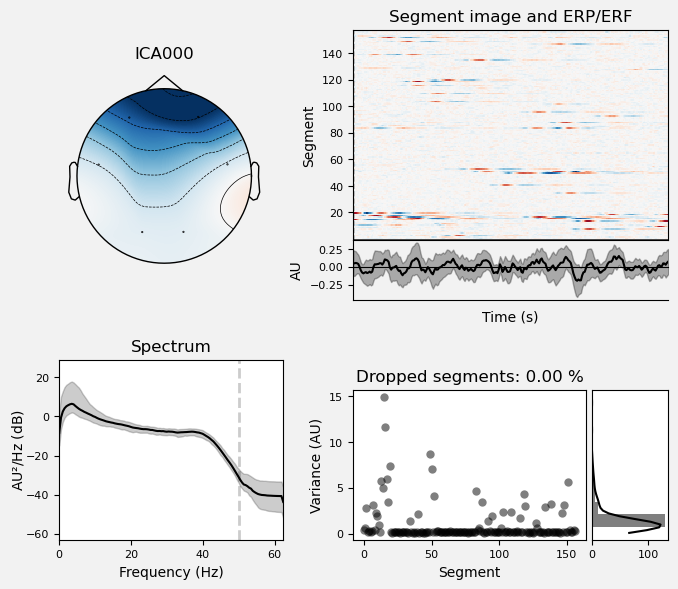

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components

 Mosgo 

Fitting ICA to data using 6 channels (please be patient, this may take a while)
Selecting by number: 6 components
Fitting ICA took 0.1s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
152 matching events found
No baseline correction applied
0 projection items activated


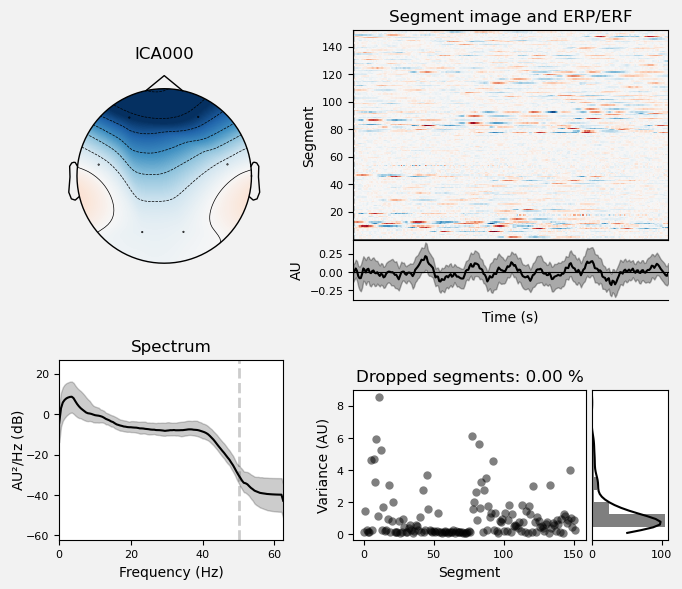

Applying ICA to Raw instance
    Transforming to ICA space (6 components)
    Zeroing out 1 ICA component
    Projecting back using 6 PCA components


In [7]:
#Рисуем коспоненты всех и исключаем компоненты глаз (выбранные руками)

#special1 = ['Sasha', 'Katya', 'Pilug']
#for i in names:
    #print('\n', i, '\n')
    # set up and fit the ICA
    #raw = raw_list[i]
    #ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
    #ica.fit(raw, picks='all')
    #ica.plot_properties(raw, picks=[0,1,2,3,4,5])
    #if i == 'Misha':
     #   ica.exclude = [2]
    #elif i in special1:
     #   ica.exclude = [1]
    #else:
     #   ica.exclude = [0]
    #ica.plot_properties(raw, picks=ica.exclude)
    #ica.apply(raw)

## Classification csp + lda


 Almaz 

Not setting metadata
40 matching events found
Setting baseline interval to [-0.1991943515174034, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 40 events and 564 original time points ...
0 bad epochs dropped
<Epochs |  40 events (all good), -0.199194 - 1.99976 sec, baseline -0.199194 – 0 sec, ~718 kB, data loaded,
 '1-back': 20
 '2-back': 20>
Computing rank from data with rank=None
    Using tolerance 3e-07 (2.2e-16 eps * 4 dim * 3.4e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.2e-07 (2.2e-16 eps * 4 dim * 3.6e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Comput

Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.9e-07 (2.2e-16 eps * 4 dim * 4.4e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.8e-07 (2.2e-16 eps * 4 dim * 4.2e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.7e-07 (2.2e-16 eps * 4 dim * 4.1e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.4e-07 (2.2e-16 eps * 4 dim * 3.8e

    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 2.7e-07 (2.2e-16 eps * 4 dim * 3e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-07 (2.2e-16 eps * 4 dim * 3e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3e-07 (2.2e-16 eps * 4 dim * 3.3e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance 

Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 2.8e-07 (2.2e-16 eps * 4 dim * 3.1e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 2.7e-07 (2.2e-16 eps * 4 dim * 3e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
--------------------------------------/////////////////////////////////------------------------------------------------------///////////////////////////////-----------
[0.625 0.5   0.375 0.75  0.375 0.625 0.625 0.625 0.75  0.625]
0.5875

 Nasty 

Not setting metadata
40 matching events found
Setting baseline interval to [-0.19918960406063604, 0.0] sec
Applying baseline correction (

Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.6e-07 (2.2e-16 eps * 4 dim * 4.1e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3e-07 (2.2e-16 eps * 4 dim * 3.4e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.4e-07 (2.2e-16 eps * 4 dim * 3.8e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.2e-07 (2.2e-16 eps * 4 dim * 3.6e+0

    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 2.9e-07 (2.2e-16 eps * 4 dim * 3.2e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 2.7e-07 (2.2e-16 eps * 4 dim * 3e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 2.8e-07 (2.2e-16 eps * 4 dim * 3.2e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covaria

Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.7e-07 (2.2e-16 eps * 4 dim * 4.2e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.1e-07 (2.2e-16 eps * 4 dim * 3.5e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 4e-07 (2.2e-16 eps * 4 dim * 4.5e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.4e-0

Setting baseline interval to [-0.19917080678150145, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 40 events and 564 original time points ...
0 bad epochs dropped
<Epochs |  40 events (all good), -0.199171 - 1.99952 sec, baseline -0.199171 – 0 sec, ~718 kB, data loaded,
 '1-back': 20
 '2-back': 20>
Computing rank from data with rank=None
    Using tolerance 3e-07 (2.2e-16 eps * 4 dim * 3.4e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.2e-07 (2.2e-16 eps * 4 dim * 3.7e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3

Computing rank from data with rank=None
    Using tolerance 3.4e-07 (2.2e-16 eps * 4 dim * 3.9e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3e-07 (2.2e-16 eps * 4 dim * 3.4e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.3e-07 (2.2e-16 eps * 4 dim * 3.7e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 2.7e-07 (2.2e-16 eps * 4 dim * 3e+08  max singular value)
    Estimated rank (mag

    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3e-07 (2.2e-16 eps * 4 dim * 3.3e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.8e-07 (2.2e-16 eps * 4 dim * 4.3e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covariance using SHRINKAGE
Done.
Computing rank from data with rank=None
    Using tolerance 3.3e-07 (2.2e-16 eps * 4 dim * 3.7e+08  max singular value)
    Estimated rank (mag): 4
    MAG: rank 4 computed from 4 data channels with 0 projectors
Reducing data rank from 4 -> 4
Estimating covaria

ValueError: 
All the 10 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
10 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\pipeline.py", line 378, in fit
    Xt = self._fit(X, y, **fit_params_steps)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\pipeline.py", line 336, in _fit
    X, fitted_transformer = fit_transform_one_cached(
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\joblib\memory.py", line 349, in __call__
    return self.func(*args, **kwargs)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\pipeline.py", line 870, in _fit_transform_one
    res = transformer.fit_transform(X, y, **fit_params)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\decoding\csp.py", line 237, in fit_transform
    return super().fit_transform(X, y=y, **fit_params)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\decoding\mixin.py", line 33, in fit_transform
    return self.fit(X, y, **fit_params).transform(X)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\decoding\csp.py", line 176, in fit
    covs, sample_weights = self._compute_covariance_matrices(X, y)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\decoding\csp.py", line 494, in _compute_covariance_matrices
    cov, weight = cov_estimator(X[y == this_class])
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\decoding\csp.py", line 510, in _concat_cov
    cov = _regularized_covariance(
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\cov.py", line 1774, in _regularized_covariance
    cov = _compute_covariance_auto(
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\cov.py", line 1043, in _compute_covariance_auto
    rank = compute_rank(
  File "<decorator-gen-94>", line 12, in compute_rank
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\rank.py", line 397, in compute_rank
    this_rank = _estimate_rank_meeg_signals(
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\rank.py", line 160, in _estimate_rank_meeg_signals
    out = estimate_rank(data, tol=tol, norm=False,
  File "<decorator-gen-91>", line 12, in estimate_rank
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\rank.py", line 55, in estimate_rank
    s = linalg.svdvals(data)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\scipy\linalg\_decomp_svd.py", line 223, in svdvals
    a = _asarray_validated(a, check_finite=check_finite)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\scipy\_lib\_util.py", line 287, in _asarray_validated
    a = toarray(a)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\numpy\lib\function_base.py", line 627, in asarray_chkfinite
    raise ValueError(
ValueError: array must not contain infs or NaNs


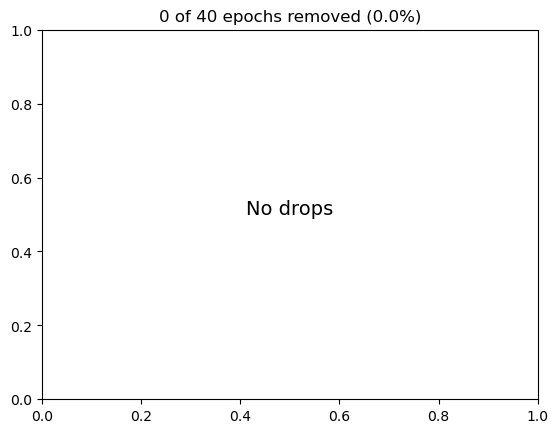

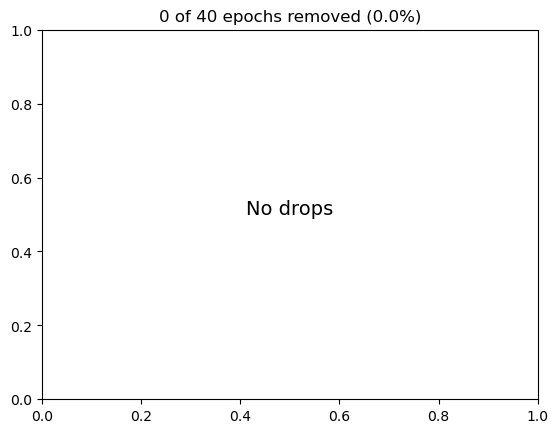

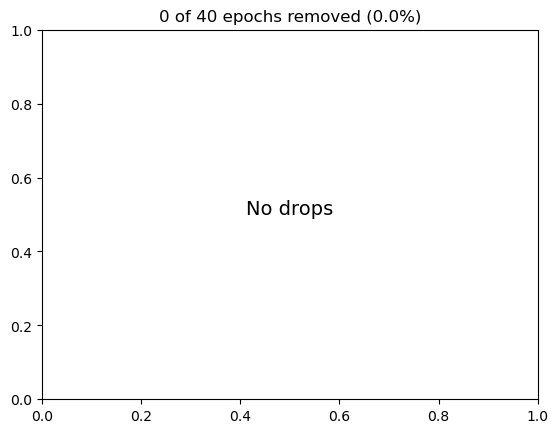

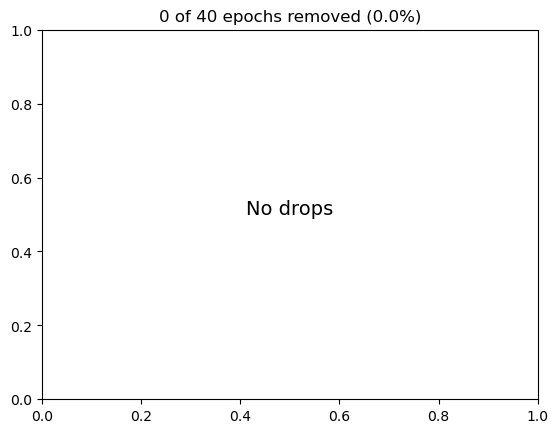

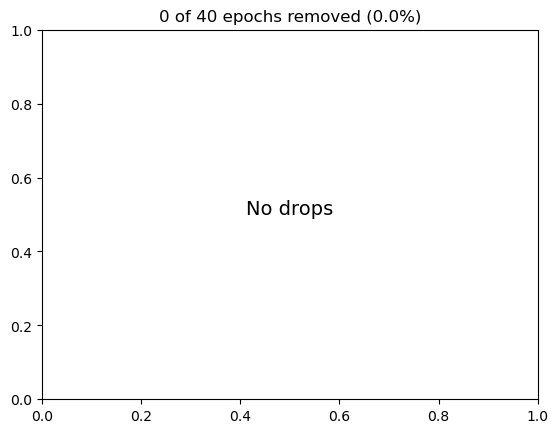

...

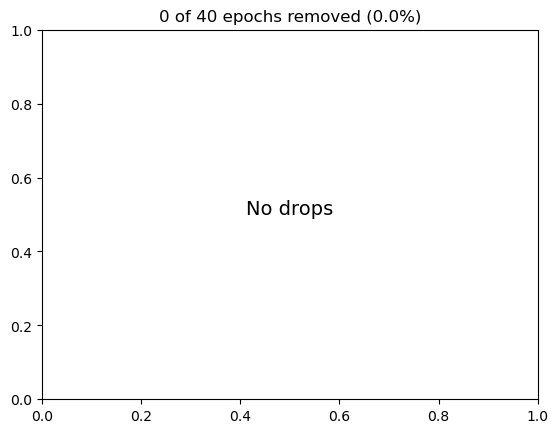

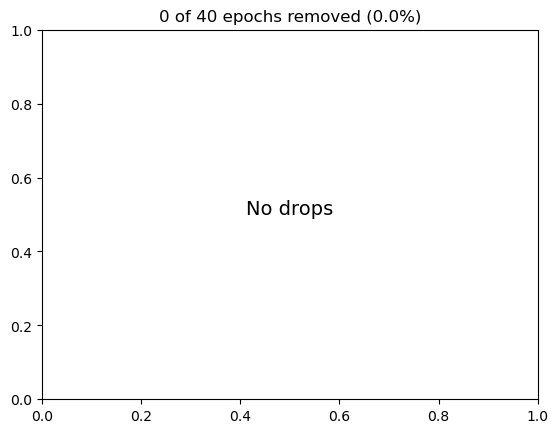

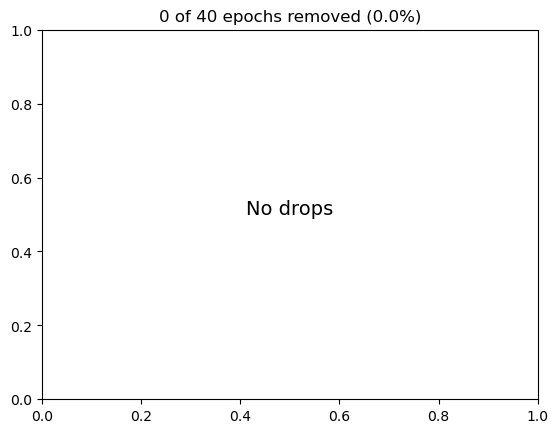

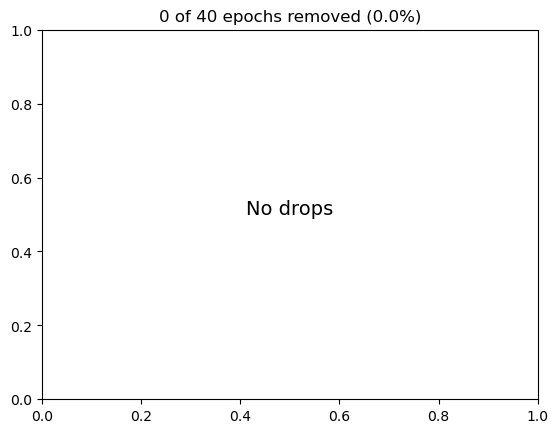

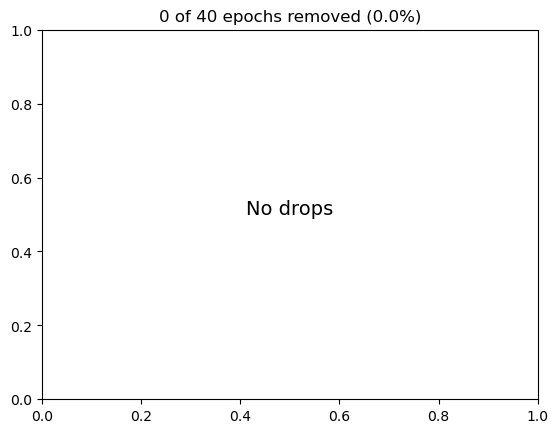

In [23]:
mm = []
n = 0
event_dict1 = {'1-back': 5, '2-back': 6}
for i in names:
    print('\n', i, '\n')
    raw = raw_list[i]
    events = events_list[i]
    events1 = events[7:]
    epo=mne.Epochs(raw,events1, event_id=event_dict1, tmin= -0.2, tmax=2, preload=True,reject=None,picks=['AF7', 'AF8', 'TP9', 'TP10'])
    epo.plot_drop_log()
    print(epo)
    #oneb = epo['1-back'].average(picks=['F3','F4'])
    #twob = epo['2-back'].average(picks=['F3','F4'])
    #fig1 = oneb.plot()
    #fig2 = twob.plot(spatial_colors=True)
    scores = []
    epochs_data = epo.get_data()
    cv = ShuffleSplit(10, test_size=0.2, random_state=42)
    cv_split = cv.split(epochs_data)
    
    lda = LinearDiscriminantAnalysis() #Создаеим объект модели классификации
    csp = CSP(n_components=3, log=True, reg=0.3, norm_trace=False) #Создаем объект CSP, который будет выделить 3 компонента
    labels = epo.events[:, -1]


    clf = Pipeline([('CSP', csp), ('LDA', lda)])# Идея данного оьъекта это объединить два объекта в жва блока последовательных преобразований

    scores = cross_val_score(clf, epochs_data, labels, cv=cv, n_jobs=1, verbose=False)
    print('--------------------------------------/////////////////////////////////------------------------------------------------------///////////////////////////////-----------')
    print(scores)
    
    n += np.count_nonzero(np.isnan(scores))
    
    cleanedList = [x for x in scores if str(x) != 'nan']
    print(statistics.mean(cleanedList))
    mm.append(statistics.mean(cleanedList))

In [24]:
#средние результаты по каждому испытуемому и по всем испытуемым
print(mm)
print(statistics.mean(mm))

[0.825, 0.6125, 0.9875, 0.5875, 0.7875, 1.0, 0.6, 0.8125, 0.9, 0.5625, 0.7125, 0.925]
0.7760416666666666


## ClumpsyClassificationWithTunung

In [18]:
def mean(data):
    return np.mean(data,axis=-1)
    
def std(data):
    return np.std(data,axis=-1)

def ptp(data):
    return np.ptp(data,axis=-1)

def var(data):
        return np.var(data,axis=-1)

def minim(data):
      return np.min(data,axis=-1)


def maxim(data):
      return np.max(data,axis=-1)

def argminim(data):
      return np.argmin(data,axis=-1)


def argmaxim(data):
      return np.argmax(data,axis=-1)

def mean_square(data):
      return np.mean(data**2,axis=-1)

def rms(data): #root mean square
      return  np.sqrt(np.mean(data**2,axis=-1))  

def abs_diffs_signal(data):
    return np.sum(np.abs(np.diff(data,axis=-1)),axis=-1)


def skewness(data):
    return stats.skew(data,axis=-1)

def kurtosis(data):
    return stats.kurtosis(data,axis=-1)

def concatenate_features(data):
    return np.concatenate((mean(data),std(data),ptp(data),var(data),minim(data),maxim(data),argminim(data),argmaxim(data),
                          mean_square(data),rms(data),abs_diffs_signal(data),
                          skewness(data),kurtosis(data)),axis=-1)

Not setting metadata
20 matching events found
Setting baseline interval to [-0.1991943515174034, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.1991943515174034, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
shapes:
(40, 4, 564) (40,) (40,)


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nAlmazResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.82
Best parameters:
{'classifier__C': 1}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19919458540104026, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19919458540104026, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from prel

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nMishaResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.6799999999999999
Best parameters:
{'classifier__C': 0.05}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19917489758895085, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19917489758895085, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Usi

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nSashaResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.9800000000000001
Best parameters:
{'classifier__C': 8}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19920011416910163, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19920011416910163, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nSonyMResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.54
Best parameters:
{'classifier__C': 1}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19918960406063604, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19918960406063604, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from prel

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nNastyResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.9
Best parameters:
{'classifier__C': 4}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19920393814351, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19920393814351, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded R

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nKatyaResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
1.0
Best parameters:
{'classifier__C': 15}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19920022708647425, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19920022708647425, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from prel

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nPilugResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.48
Best parameters:
{'classifier__C': 0.05}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19919946900975916, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19919946900975916, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from p

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nKurkiResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.78
Best parameters:
{'classifier__C': 0.05}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19916908046359463, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19916908046359463, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from p

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nMedveResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.8
Best parameters:
{'classifier__C': 0.1}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19917080678150145, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19917080678150145, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from pre

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nKobloResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.56
Best parameters:
{'classifier__C': 0.1}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.20016652813515293, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 562 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.20016652813515293, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from pr

C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\viz\epochs.py:619: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nBaltsResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.62
Best parameters:
{'classifier__C': 2}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19917031810926347, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 564 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.19917031810926347, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from prel

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

/n/nDolgiResults/n
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Best score:
0.7000000000000001
Best parameters:
{'classifier__C': 0.05}
_________________________________________________________________________________________________________________________________________________________________________________________________________________________________
Not setting metadata
20 matching events found
Setting baseline interval to [-0.20130724621025883, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 20 events and 570 original time points ...
0 bad epochs dropped
Not setting metadata
20 matching events found
Setting baseline interval to [-0.20130724621025883, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Usi

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_15100\736822184.py:34: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for data in tqdm_notebook(data_array):


  0%|          | 0/40 [00:00<?, ?it/s]

ValueError: 
All the 65 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
65 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\pipeline.py", line 382, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\linear_model\_logistic.py", line 1138, in fit
    X, y = self._validate_data(
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\base.py", line 596, in _validate_data
    X, y = check_X_y(X, y, **check_params)
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\utils\validation.py", line 1074, in check_X_y
    X = check_array(
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\utils\validation.py", line 899, in check_array
    _assert_all_finite(
  File "C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\sklearn\utils\validation.py", line 146, in _assert_all_finite
    raise ValueError(msg_err)
ValueError: Input X contains NaN.
LogisticRegression does not accept missing values encoded as NaN natively. For supervised learning, you might want to consider sklearn.ensemble.HistGradientBoostingClassifier and Regressor which accept missing values encoded as NaNs natively. Alternatively, it is possible to preprocess the data, for instance by using an imputer transformer in a pipeline or drop samples with missing values. See https://scikit-learn.org/stable/modules/impute.html You can find a list of all estimators that handle NaN values at the following page: https://scikit-learn.org/stable/modules/impute.html#estimators-that-handle-nan-values


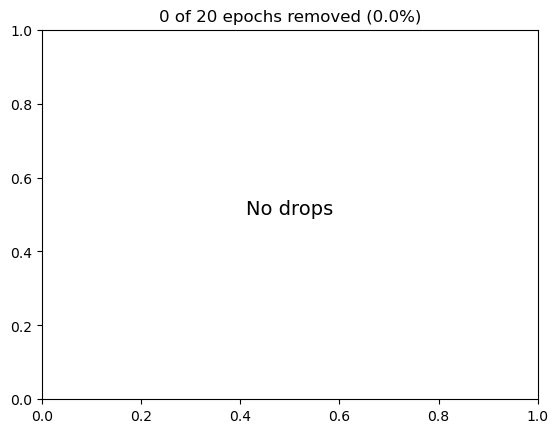

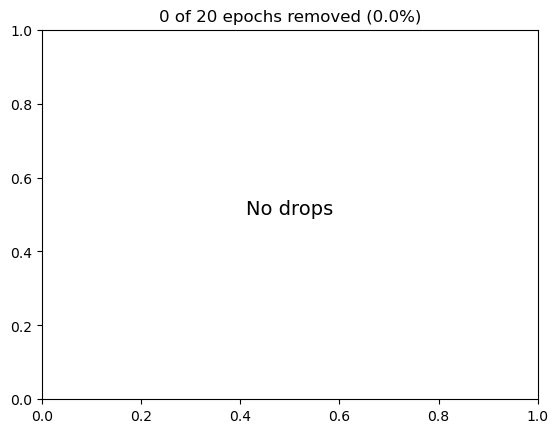

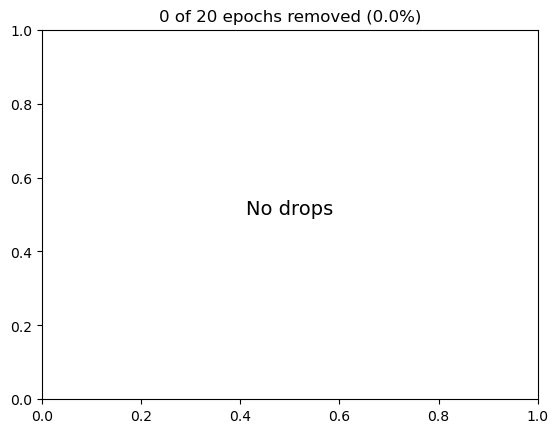

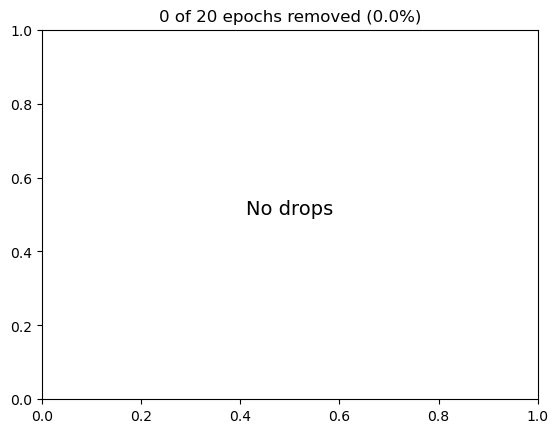

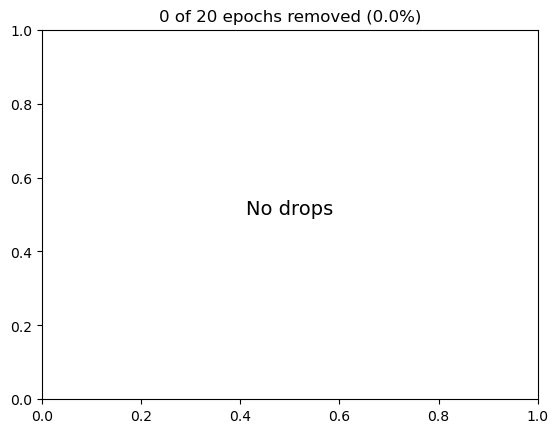

...

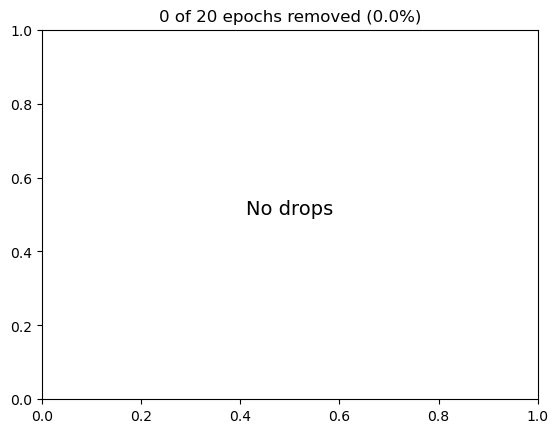

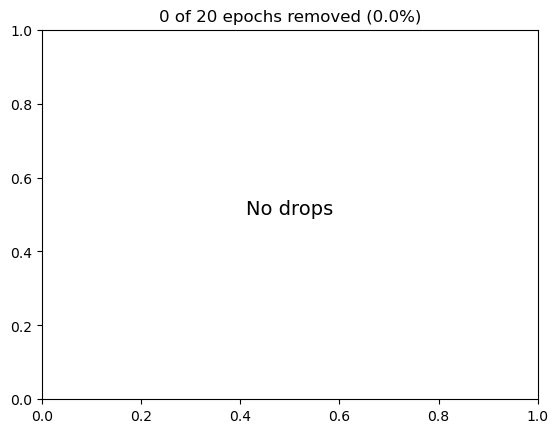

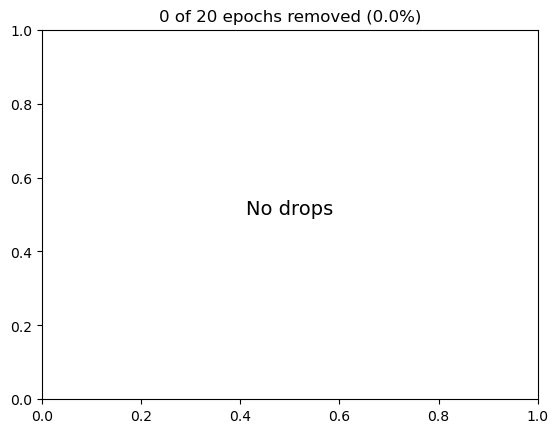

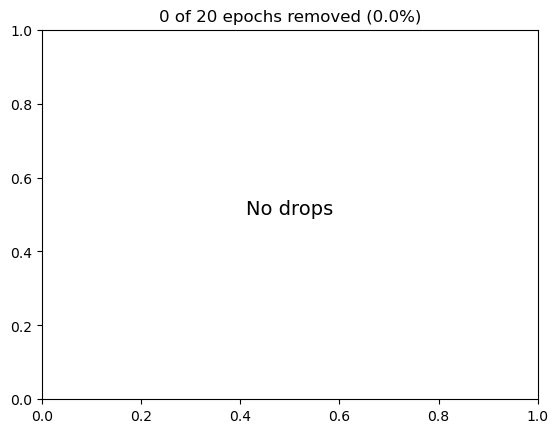

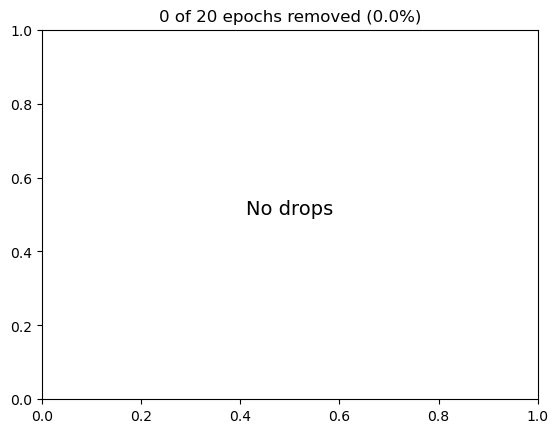

In [21]:
scores = []
for i in names:
    raw = raw_list[i]
    events = events_list[i]
    events11 = events[7:27]
    event_dict11 = {'1-back': 5}
    epochs1b = mne.Epochs(raw,events11, event_id=event_dict11, tmin= -0.2, tmax=2, preload=True,picks=['AF7', 'AF8', 'TP9', 'TP10'],reject=None)
    epochs1b.plot_drop_log()
    epochs1b = epochs1b.get_data()

    events1 = events[27:]
    event_dict1 = {'2-back': 6}

    epochs2b=mne.Epochs(raw,events1, event_id=event_dict1, tmin= -0.2, tmax=2, preload=True,picks=['AF7', 'AF8', 'TP9', 'TP10'],reject=None)
    epochs2b.plot_drop_log()
    epochs2b = epochs2b.get_data()
    
    b_epochs_labels = [1] * 20
    bb_epochs_labels = [2] * 20
    label_list=b_epochs_labels+bb_epochs_labels
    label_array=np.array(label_list)

    group_array = [0] * 5 + [1] * 5 + [2] * 5 + [3] * 5 + [4] * 5 + [5] * 5 + [6] * 5 + [7] * 5
    group_array=np.array(group_array)

    #data_list=[i for i in epochs1b]+[l for l in epochs2b]

    data_array = np.concatenate((epochs1b, epochs2b), axis=0)
    print('shapes:')
    print(data_array.shape,label_array.shape,group_array.shape)
    
    #делаем фичи - в каждой эпохе 13 параметров (типа среднего, минимального и т.д.) на каждый из 6 каналов = итого78 
    features=[]
    for data in tqdm_notebook(data_array):
        features.append(concatenate_features(data))
    features=np.array(features)
    features.shape
    
    #GridSearchCV это hyperparametric tunung, то есть чтобы подобрать идеальные параметры для классификатора
    #в данном случае подбираем только параметр С - Inverse of regularization strength;
    
    clf=LogisticRegression()
    gkf=GroupKFold(n_splits=5)
    param_grid = {'classifier__C': [0.01,0.05,0.1,0.5, 1,2,3,4,5,8, 10,12,15]}
    pipe=Pipeline([('scaler',StandardScaler()),('classifier',clf)])
    gscv=GridSearchCV(pipe,param_grid,cv=gkf,n_jobs=16)
    gscv.fit(features,label_array,groups=group_array)
    
    print('/n/n'+i+'Results'+'/n')
    print('_________________________________________________________________________________________________________________________________________________________________________________________________________________________________')
    print('Best score:')
    print(gscv.best_score_)
    scores.append(gscv.best_score_)
    print('Best parameters:')
    print(gscv.best_params_)
    print('_________________________________________________________________________________________________________________________________________________________________________________________________________________________________')


In [22]:
print(sum(scores)/len(scores))

0.7383333333333333


## ERPs

In [4]:
event_dict = {'blinking starts': 2, 'blinking ends': 22, 'EO start': 3, 'EO end': 33,
              'EC start': 4, 'EC end': 44, '1-back': 5, '2-back': 6}

In [5]:
for i in names:
    print('\n', i, '\n')
    raw = raw_list[i]
    events = events_list[i]
    epo=mne.Epochs(raw,events, event_id=event_dict, tmin= -0.2, tmax=1, preload=True,picks=['AF7', 'AF8', 'TP9', 'TP10'],reject=None)
    epo.plot_drop_log()
    print(epo)
    oneb = epo['1-back'].average(picks=['AF7','AF8'])
    twob = epo['2-back'].average(picks=['AF7','AF8'])
    fig1 = oneb.plot()
    fig2 = twob.plot(spatial_colors=True)


 Almaz 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.1991943515174034, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199194 - 0.999878 sec, baseline -0.199194 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>

 Misha 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19919458540104026, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199195 - 0.999879 sec, baseline -0.199195 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1

C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\viz\evoked.py:340: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(len(ch_types_used), 1)



 Kurki 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19919946900975916, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199199 - 0.999903 sec, baseline -0.199199 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>

 Medve 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19916908046359463, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199169 - 0.999751 sec, baseline -0.199169 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 

ValueError: Some of the values  to be plotted are NaN.


 Almaz 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.1991943515174034, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199194 - 0.999878 sec, baseline -0.199194 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


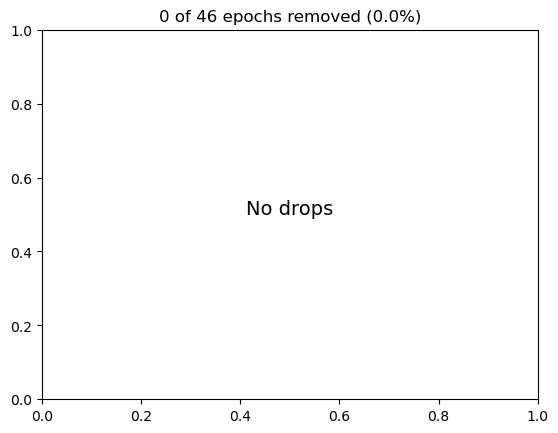

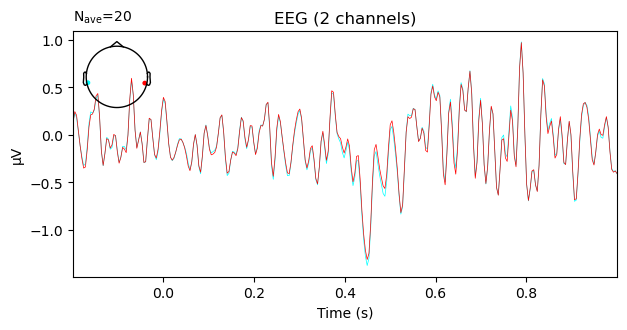

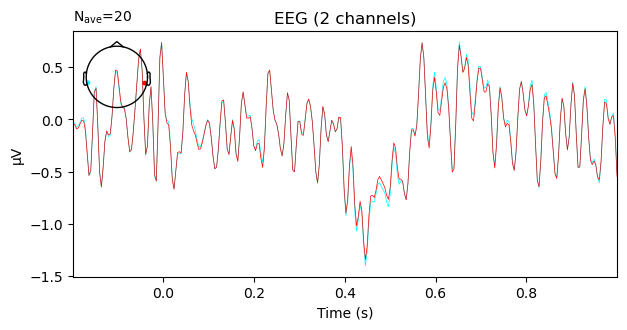


 Misha 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19919458540104026, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199195 - 0.999879 sec, baseline -0.199195 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


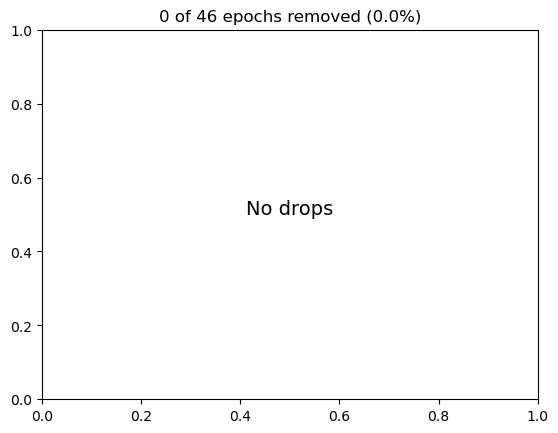

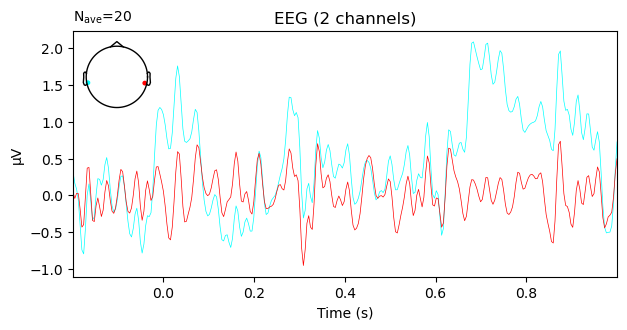

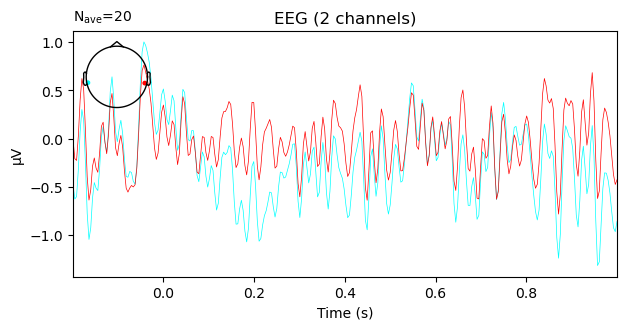


 Sasha 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19917489758895085, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199175 - 0.99978 sec, baseline -0.199175 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


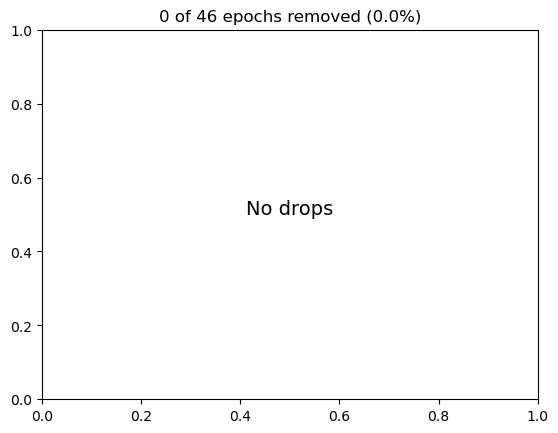

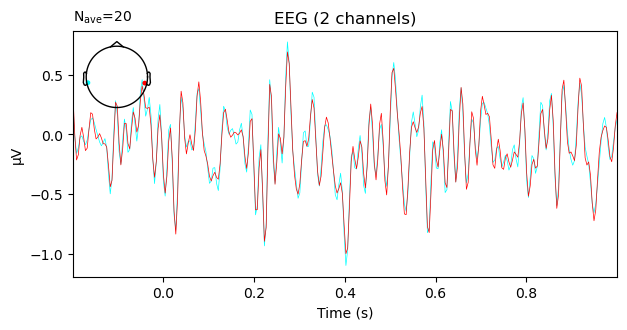

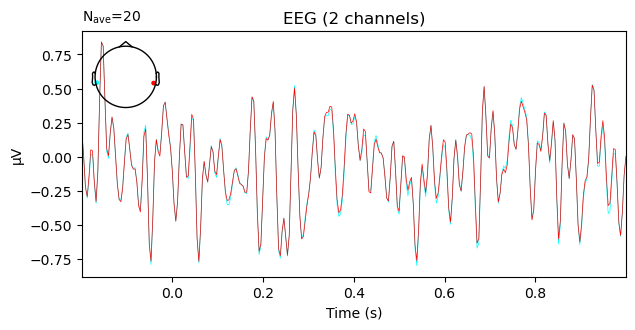


 SonyM 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19920011416910163, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.1992 - 0.999906 sec, baseline -0.1992 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


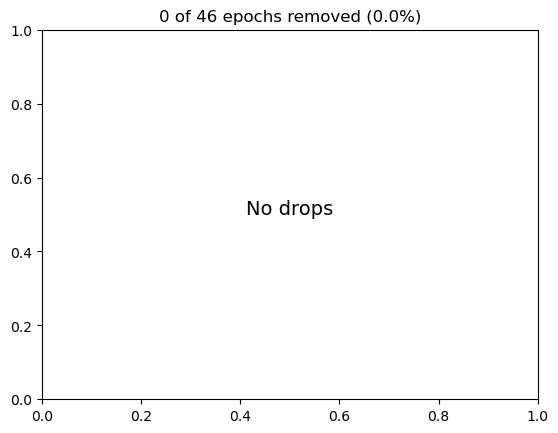

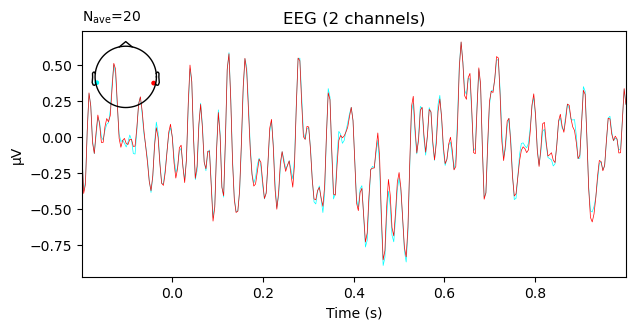

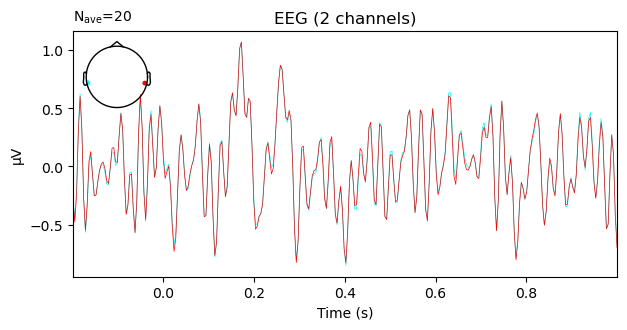


 Nasty 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19918960406063604, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.19919 - 0.999854 sec, baseline -0.19919 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


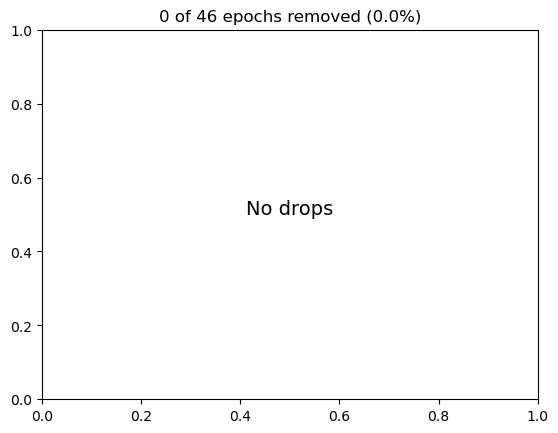

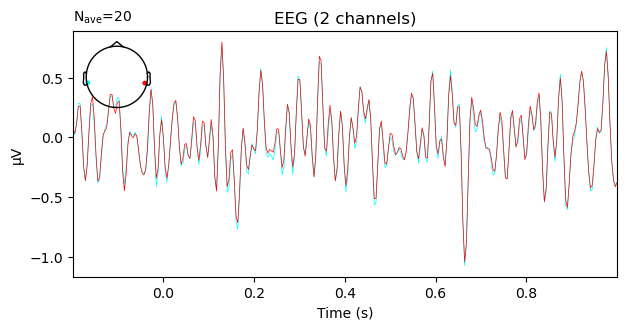

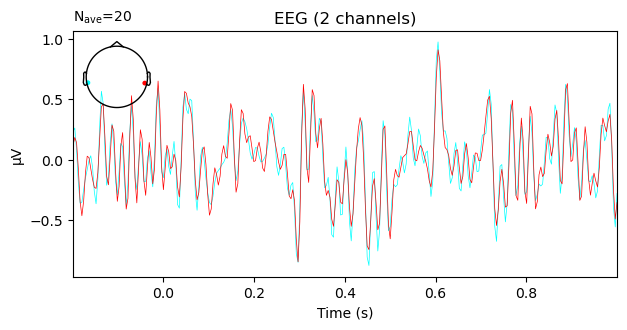


 Katya 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19920393814351, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199204 - 0.999926 sec, baseline -0.199204 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


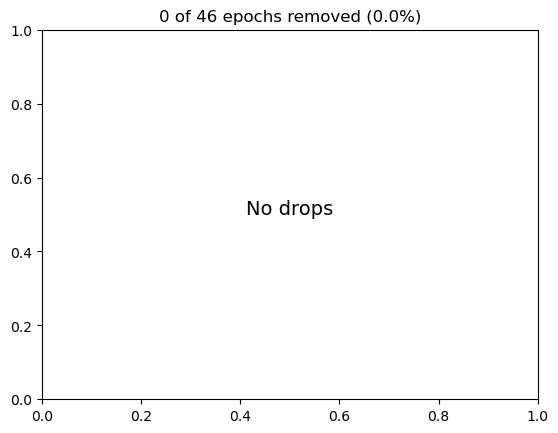

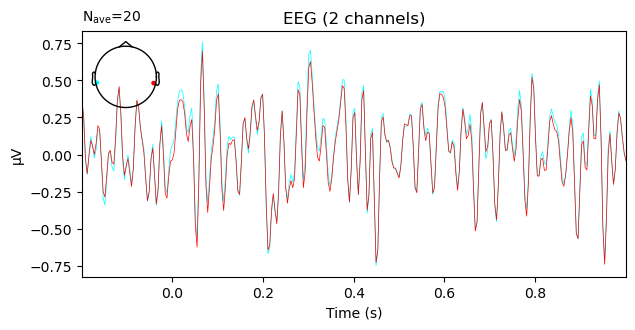

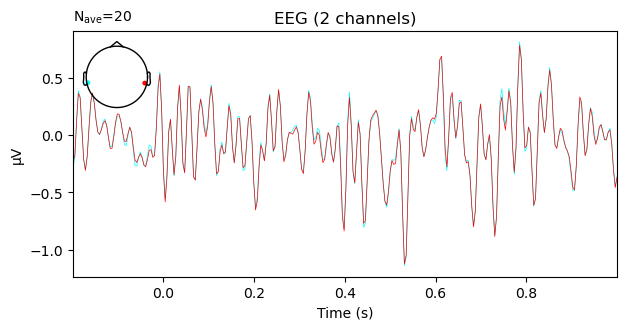


 Pilug 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19920022708647425, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.1992 - 0.999907 sec, baseline -0.1992 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


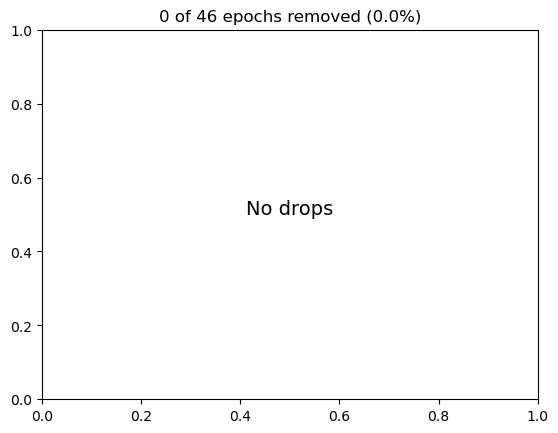

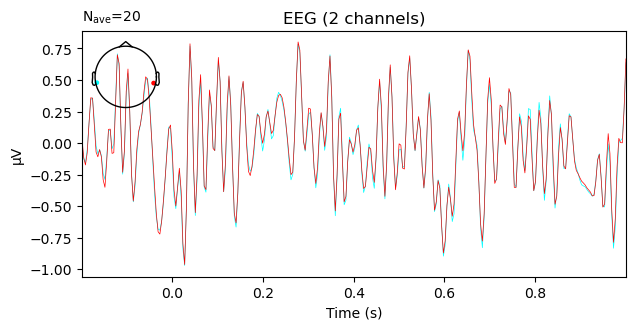

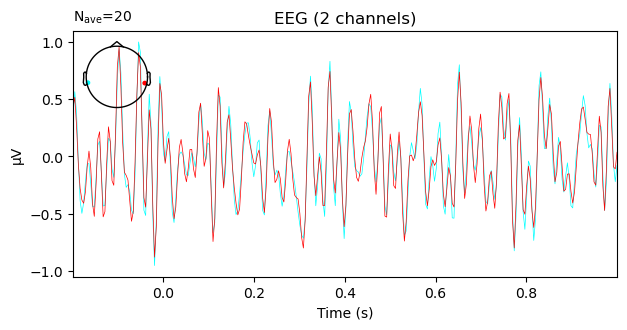


 Kurki 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19919946900975916, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199199 - 0.999903 sec, baseline -0.199199 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


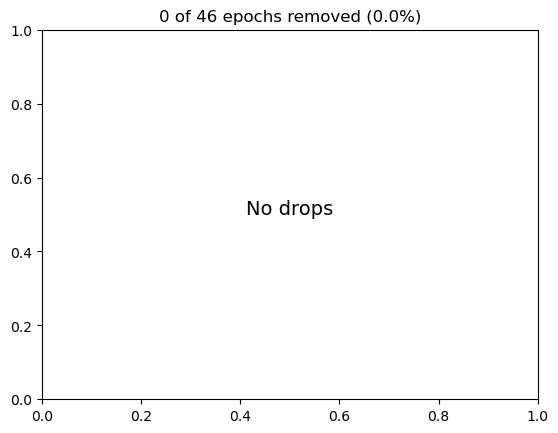

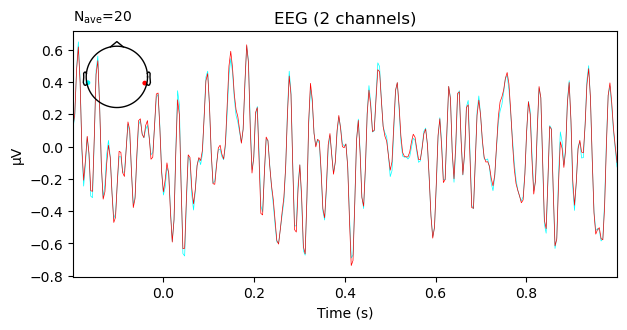

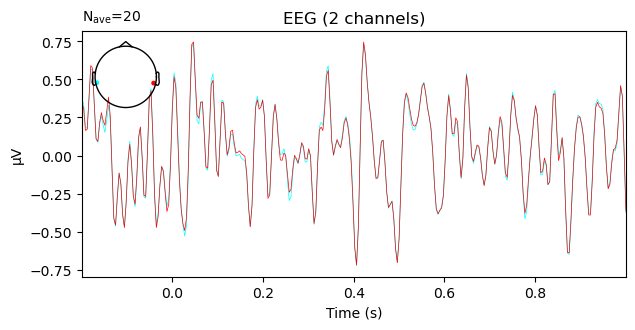


 Medve 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19916908046359463, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199169 - 0.999751 sec, baseline -0.199169 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


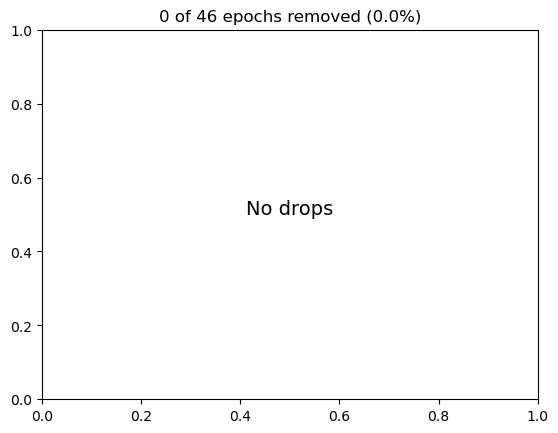

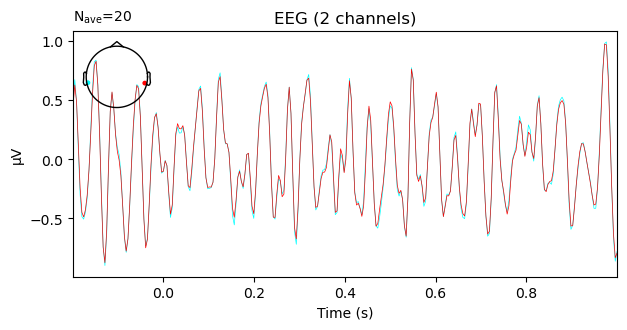

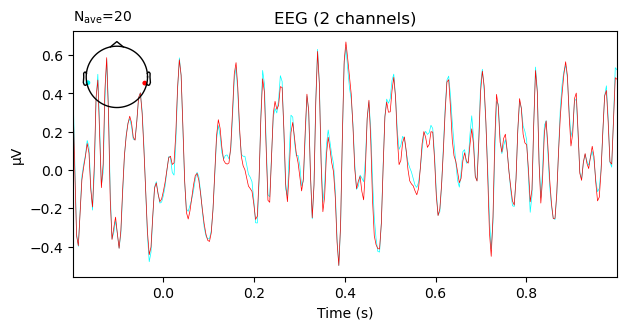


 Koblo 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19917080678150145, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.199171 - 0.999759 sec, baseline -0.199171 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


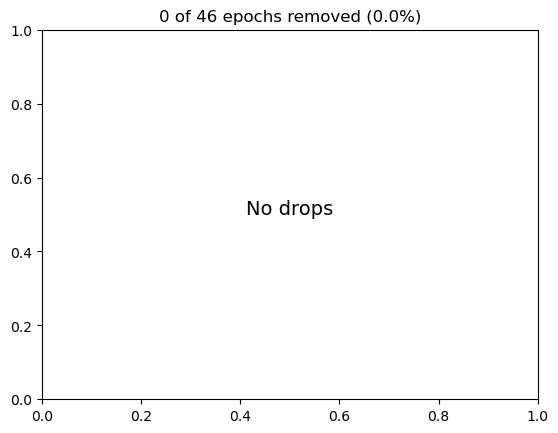

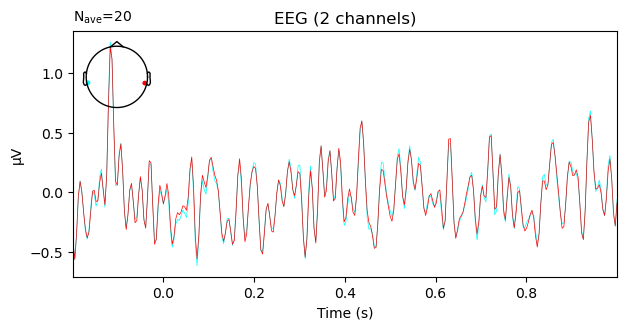

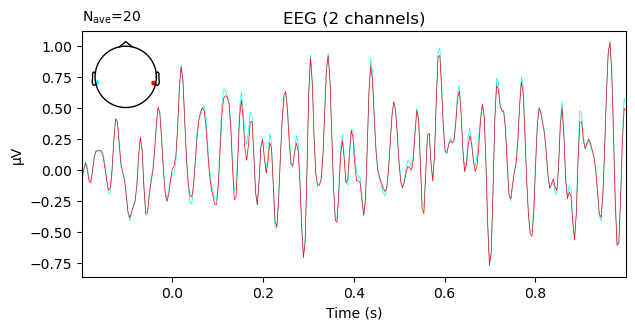


 Balts 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.20016652813515293, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 307 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.200167 - 1.00083 sec, baseline -0.200167 – 0 sec, ~454 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


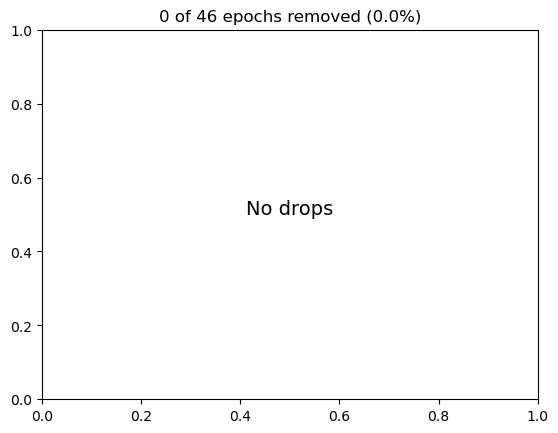

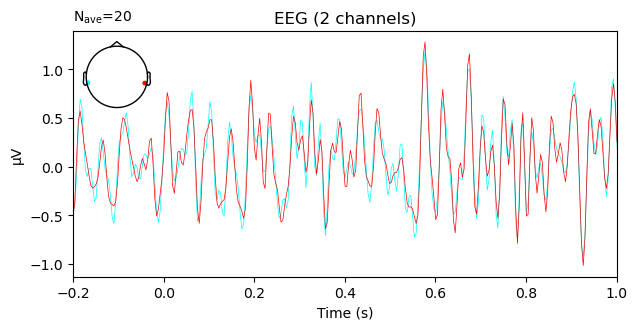

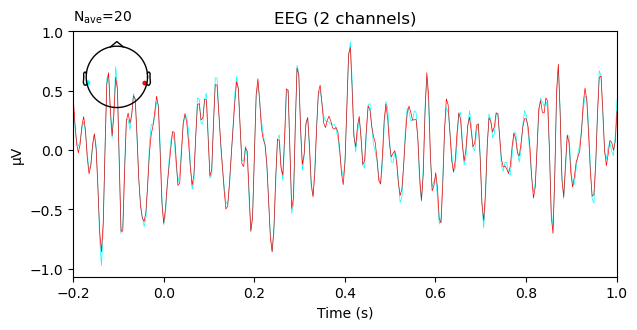


 Dolgi 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.19917031810926347, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 308 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.19917 - 0.999757 sec, baseline -0.19917 – 0 sec, ~455 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


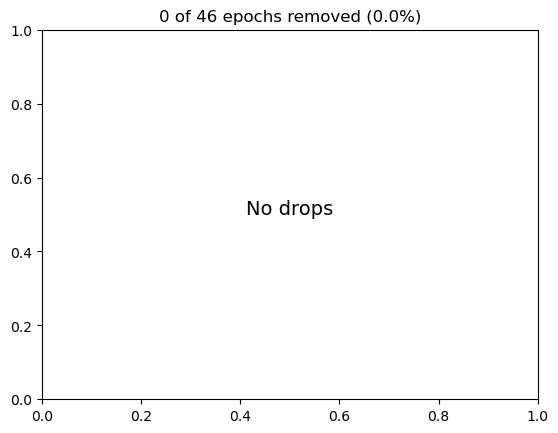

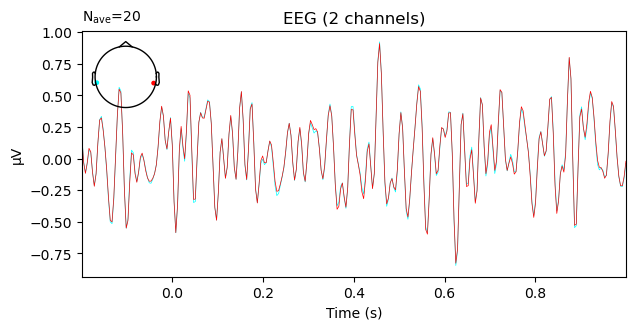

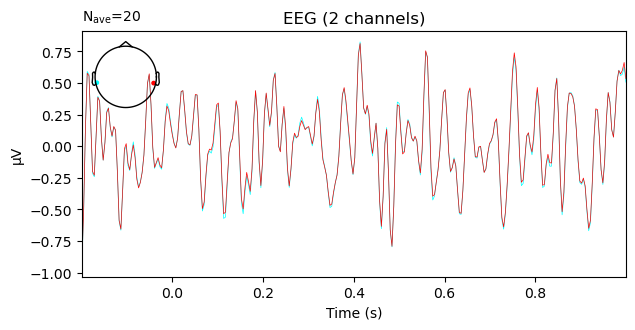


 Mozgo 

Not setting metadata
46 matching events found
Setting baseline interval to [-0.20130724621025883, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 46 events and 311 original time points ...
0 bad epochs dropped
<Epochs |  46 events (all good), -0.201307 - 0.998794 sec, baseline -0.201307 – 0 sec, ~460 kB, data loaded,
 'blinking starts': 1
 'blinking ends': 1
 'EO start': 1
 'EO end': 1
 'EC start': 1
 'EC end': 1
 '1-back': 20
 '2-back': 20>


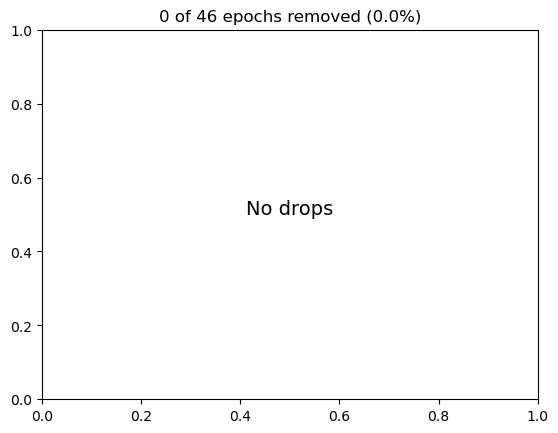

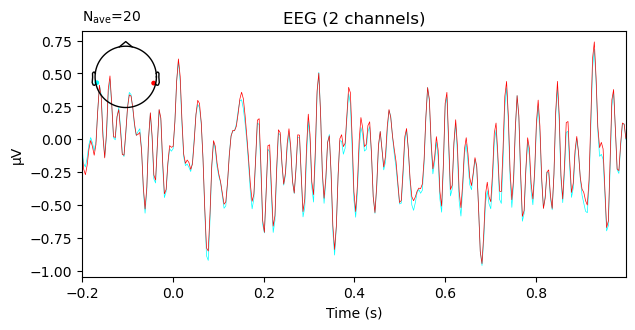

ValueError: Some of the values  to be plotted are NaN.

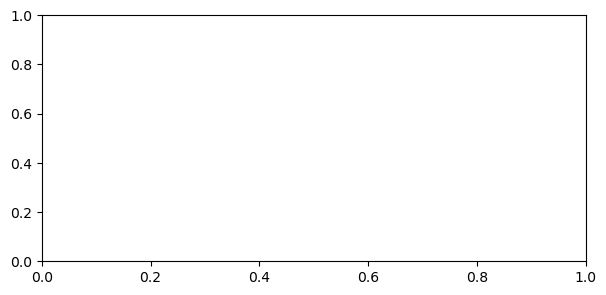

In [28]:
for i in names:
    print('\n', i, '\n')
    raw = raw_list[i]
    events = events_list[i]
    epo=mne.Epochs(raw,events, event_id=event_dict, tmin= -0.2, tmax=1, preload=True,picks=['AF7', 'AF8', 'TP9', 'TP10'],reject=None)
    epo.plot_drop_log()
    print(epo)
    oneb = epo['1-back'].average(picks=['TP9', 'TP10'])
    twob = epo['2-back'].average(picks=['TP9', 'TP10'])
    fig1 = oneb.plot()
    fig2 = twob.plot(spatial_colors=True)

In [9]:
raw.plot()

Using qt as 2D backend.


Channels marked as bad:
none


## plot psd

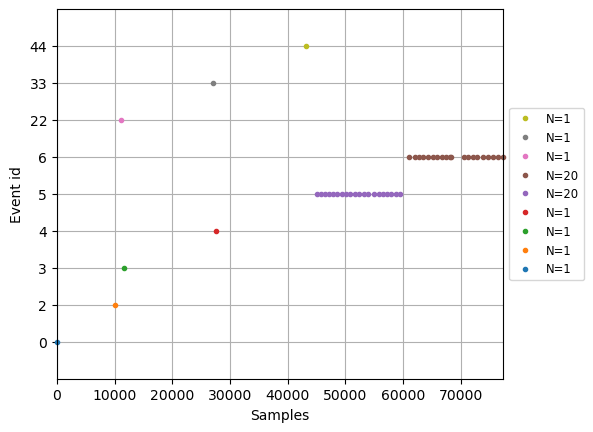

In [7]:
%matplotlib inline
fig = mne.viz.plot_events(events)

In [22]:
import math

In [23]:
psd = {}
#ec
for i in names:
    raw = raw_list[i]
    events = events_list[i]
    #if events[3][2] == 3:
        #eot1 = events[3][0] / raw.info['sfreq']
        #eot2 = events[4][0] / raw.info['sfreq']
        #print(eot1,eot2)
        #raw_eo = raw.copy().crop(tmin=eot1, tmax=eot2)
        #psd_eo = raw_eo.compute_psd(picks=['O1'])
    if events[5][2] == 4:
        ect1 = events[5][0] / raw.info['sfreq']
        ect2 = events[6][0] / raw.info['sfreq']
        print(ect1,ect2)
        raw_ec = raw.copy().crop(tmin=ect1, tmax=ect2)
        psd_ec = raw_ec.compute_psd(picks=['TP9'],fmin=0, fmax=60)
        psd_ec = psd_ec.get_data(return_freqs=True)
    yy_ec = psd_ec[0][0]
    x_ec = psd_ec[1]
    y_ec = []
    for i in range(len(yy_ec)):
        n = (yy_ec[i] ** 2) / x_ec[i]
        n = math.log(n,10)
        y_ec.append(n)
    plt.plot(x_ec,y_ec)

90.87168200791974 151.85639974503223
Effective window size : 1.000 (s)


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_28332\3490486797.py:23: RuntimeWarning: divide by zero encountered in double_scalars
  n = (yy_ec[i] ** 2) / x_ec[i]


131.03097943204114 192.01576877423415
Effective window size : 1.000 (s)
106.71088042589203 167.68573681915262
Effective window size : 1.000 (s)
101.70532887939682 162.6761873535081
Effective window size : 1.000 (s)
91.58425540427166 152.55580263938126
Effective window size : 1.000 (s)
94.7781090010249 155.7657617495105
Effective window size : 1.000 (s)
112.2200338121861 173.20264450828654
Effective window size : 1.000 (s)
115.35211604441602 176.33840053693328
Effective window size : 1.000 (s)
93.89845824836605 154.8598179745761
Effective window size : 1.000 (s)
108.30205516989409 169.2756592145918
Effective window size : 1.000 (s)
111.52023000847521 172.4885995781118
Effective window size : 1.005 (s)
89.13067000407295 150.0924085469279
Effective window size : 1.000 (s)
106.80123670093501 167.22050961638712
Effective window size : 0.991 (s)


In [24]:
#eo
for i in names:
    raw = raw_list[i]
    events = events_list[i]
    if events[3][2] == 3:
        eot1 = events[3][0] / raw.info['sfreq']
        eot2 = events[4][0] / raw.info['sfreq']
        print(eot1,eot2)
        raw_eo = raw.copy().crop(tmin=eot1, tmax=eot2)
        psd_eo = raw_eo.compute_psd(picks=['TP9'],fmin=0, fmax=60)
        psd_eo = psd_eo.get_data(return_freqs=True)
    #for ec
    yy_eo = psd_eo[0][0]
    x_eo = psd_eo[1]
    y_eo = []
    for i in range(len(yy_eo)):
        if x_eo[i] == 0:
            x_eo[i] = 0.1
        n = (yy_eo[i] ** 2) / x_eo[i]
        n = math.log(n,10)
        y_eo.append(n)
    plt.plot(x_eo,y_eo)

25.0438074888155 85.05989386952963
Effective window size : 1.000 (s)
64.77729801718142 124.78564331329088
Effective window size : 1.000 (s)
41.748620690703625 101.73931876646586
Effective window size : 1.000 (s)
39.96891702534151 99.95939846697351
Effective window size : 1.000 (s)
29.401947830754274 89.40488679513763
Effective window size : 1.000 (s)
27.685441442376447 87.67707450014449
Effective window size : 1.000 (s)
46.80424159171021 106.79866292598952
Effective window size : 1.000 (s)
37.75806405720278 97.7522570766126
Effective window size : 1.000 (s)
27.606396662689225 87.60705847136899
Effective window size : 1.000 (s)
40.18563925062059 100.18682112103212
Effective window size : 1.000 (s)
41.834804380246965 101.83766481417281
Effective window size : 1.005 (s)
21.166727924553097 81.18338378147783
Effective window size : 1.000 (s)
45.127664789865136 104.60234216540758
Effective window size : 0.991 (s)


In [25]:
#1b
for i in names:
    raw = raw_list[i]
    events = events_list[i]
    if (events[7][2] == 5) and (events[26][2] == 5):
        e1t1 = events[7][0] / raw.info['sfreq']
        e1t2 = events[26][0] / raw.info['sfreq']
        print(e1t1,e1t2)
        raw_e1 = raw.copy().crop(tmin=e1t1, tmax=e1t2)
        psd_e1 = raw_e1.compute_psd(picks=['TP9'],fmin=0, fmax=60)
        psd_e1 = psd_e1.get_data(return_freqs=True)
    #for 1 back
    yy_e1 = psd_e1[0][0]
    x_e1 = psd_e1[1]
    y_e1 = []
    for i in range(len(yy_e1)):
        if x_e1[i] == 0:
            x_e1[i] = 0.1
        n = (yy_e1[i] ** 2) / x_e1[i]
        n = math.log(n,10)
        y_e1.append(n)
    plt.plot(x_e1,y_e1)

158.81648473334621 215.18458044117298
Effective window size : 1.000 (s)
197.87443305073532 251.23905305729244
Effective window size : 1.000 (s)
177.49217148279683 236.03396981335317
Effective window size : 1.000 (s)
166.4727071764957 226.8850241540152
Effective window size : 1.000 (s)
157.3402588153475 213.2773864497873
Effective window size : 1.000 (s)
163.78469674967963 219.1438617557182
Effective window size : 1.000 (s)
186.4982831946073 241.52441651214158
Effective window size : 1.000 (s)
180.31067230130435 236.8169216770727
Effective window size : 1.000 (s)
163.66231027584948 222.70227416699896
Effective window size : 1.000 (s)
177.18781714673534 235.95882638702585
Effective window size : 1.000 (s)
185.51904807632175 245.6475031945677
Effective window size : 1.005 (s)
164.3975237475991 221.40709833110947
Effective window size : 1.000 (s)
174.3436890976732 230.2800044917507
Effective window size : 0.991 (s)


In [26]:
#2b
#1b
for i in names:
    raw = raw_list[i]
    events = events_list[i]
    if (events[27][2] == 6) and (events[46][2] == 6):
        e1t1 = events[27][0] / raw.info['sfreq']
        e1t2 = events[46][0] / raw.info['sfreq']
        print(e1t1,e1t2)
        raw_e1 = raw.copy().crop(tmin=e1t1, tmax=e1t2)
        psd_e1 = raw_e1.compute_psd(picks=['TP9'],fmin=0, fmax=60)
        psd_e1 = psd_e1.get_data(return_freqs=True)
    #for 1 back
    yy_e1 = psd_e1[0][0]
    x_e1 = psd_e1[1]
    y_e1 = []
    for i in range(len(yy_e1)):
        if x_e1[i] == 0:
            x_e1[i] = 0.1
        n = (yy_e1[i] ** 2) / x_e1[i]
        n = math.log(n,10)
        y_e1.append(n)
    plt.plot(x_e1,y_e1)

220.32457586464167 280.4773642512991
Effective window size : 1.000 (s)
255.23466209386623 312.9971860839836
Effective window size : 1.000 (s)
249.18341844437273 311.8375926016186
Effective window size : 1.000 (s)
231.21274428145375 290.44548411232483
Effective window size : 1.000 (s)
218.5227126900507 280.9706064023156
Effective window size : 1.000 (s)
229.30716856060866 290.5448027216665
Effective window size : 1.000 (s)
249.37134310462642 313.6934870195295
Effective window size : 1.000 (s)
241.56646195777597 301.71688985484053
Effective window size : 1.000 (s)
230.46205775290412 292.9855279141227
Effective window size : 1.000 (s)
243.20317631996085 304.3564246217556
Effective window size : 1.000 (s)
252.75537736030813 319.5325010797491
Effective window size : 1.005 (s)
230.77200858259994 291.7962319311362
Effective window size : 1.000 (s)
236.2301821345424 299.66132115675566
Effective window size : 0.991 (s)


## Считаем psd и колмогоров смирнов: закрытые глаза vs открытых и открытые глаза vs открытых

In [30]:
diff = 0
equa = 0
for i in names:
    print('\n', i, '\n')
    raw = raw_list[i]
    events = events_list[i]
    if events[3][2] == 3:
        eot1 = events[3][0] / raw.info['sfreq']
        eot2 = events[4][0] / raw.info['sfreq']
        print(eot1,eot2)
        raw_eo = raw.copy().crop(tmin=eot1, tmax=eot2)
    if events[5][2] == 4:
        ect1 = events[5][0] / raw.info['sfreq']
        ect2 = events[6][0] / raw.info['sfreq']
        print(ect1,ect2)
        raw_ec = raw.copy().crop(tmin=ect1, tmax=ect2)
    #raw_ec.plot(events=events)
    #raw_eo.plot(events=events)
    psd_ecl = raw_ec.compute_psd(picks=['TP9', 'TP10'],fmin=8,fmax=12)
    psd_ecl_lil = np.concatenate([psd_ecl._data[0], psd_ecl._data[1]])
    psd_eol = raw_eo.compute_psd(picks=['TP9', 'TP10'],fmin=8,fmax=12)
    psd_eol_lil = np.concatenate([psd_eol._data[0], psd_eol._data[1]])
    ans1 = str(scipy.stats.kstest(psd_ecl_lil, psd_eol_lil))
    nbeg = ans1.rfind('e=')
    print(ans1)
    ans1 = ans1.replace("e", "E" )
    nbeg += 2
    nend = len(ans1) - 1
    p = float(ans1[nbeg:nend])
    p = round(p, 5)
    if p < 0.05:
        ans = 'different'
        diff += 1
    else:
        ans = 'equal'
        equa += 1
    print(p,ans,sep='\n')
print('total number of different:', diff)
print('total number of equal:', equa)


 Almaz 

25.0438074888155 85.05989386952963
90.87168200791974 151.85639974503223
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.25, pvalue=0.98010878010878)
0.98011
equal

 Misha 

64.77729801718142 124.78564331329088
131.03097943204114 192.01576877423415
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.25, pvalue=0.98010878010878)
0.98011
equal

 Sasha 

41.748620690703625 101.73931876646586
106.71088042589203 167.68573681915262
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.375, pvalue=0.6601398601398599)
0.66014
equal

 SonyM 

39.96891702534151 99.95939846697351
101.70532887939682 162.6761873535081
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
KstestResult(statistic=0.5, pvalue=0.2826728826728826)
0.28267
equal

 Nasty 

29.401947830754274 89.40488679513763
91.58425540427166 152.55580263938126
Effective window size : 1.000 (s

### plor psd

In [7]:
diff = 0
equa = 0
for i in names:
    print('\n', i, '\n')
    raw = raw_list[i]
    events = events_list[i]
    if events[3][2] == 3:
        eot1 = events[3][0] / raw.info['sfreq']
        eot2 = events[4][0] / raw.info['sfreq']
        print(eot1,eot2)
        raw_eo = raw.copy().crop(tmin=eot1, tmax=eot2)
    if events[5][2] == 4:
        ect1 = events[5][0] / raw.info['sfreq']
        ect2 = events[6][0] / raw.info['sfreq']
        print(ect1,ect2)
        raw_ec = raw.copy().crop(tmin=ect1, tmax=ect2)
    #raw_ec.plot(events=events)
    #raw_eo.plot(events=events)
    psd_ecl = raw_ec.compute_psd(picks=['TP9', 'TP10'], fmin=0, fmax=60)
    psd_eol = raw_eo.compute_psd(picks=['TP9', 'TP10'], fmin=0, fmax=60)
    print('eyes open')
    psd_eol.plot()
    plt.savefig('C:\\Users\\Lenovo\\1easyEEG\\psd\\' + i + '_Muse_EO.png')
    print('eyes closed')
    psd_ecl.plot()
    plt.savefig('C:\\Users\\Lenovo\\1easyEEG\\psd\\' + i + '_Muse_EC.png')


 Almaz 

25.0438074888155 85.05989386952963
90.87168200791974 151.85639974503223
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
eyes open
eyes closed

 Misha 

64.77729801718142 124.78564331329088
131.03097943204114 192.01576877423415
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
eyes open
eyes closed

 Sasha 

41.748620690703625 101.73931876646586
106.71088042589203 167.68573681915262
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
eyes open
eyes closed

 SonyM 

39.96891702534151 99.95939846697351
101.70532887939682 162.6761873535081
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
eyes open
eyes closed

 Nasty 

29.401947830754274 89.40488679513763
91.58425540427166 152.55580263938126
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
eyes open
eyes closed

 Katya 

27.685441442376447 87.67707450014449
94.7781090010249 155.7657617495105
Effective window size : 1.000 (s)
Effective wind

C:\Users\Lenovo\anaconda3\envs\mne\lib\site-packages\mne\viz\_mpl_figure.py:2083: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(FigureClass=FigureClass, **kwargs)


eyes closed

 Dolgi 

21.166727924553097 81.18338378147783
89.13067000407295 150.0924085469279
Effective window size : 1.000 (s)
Effective window size : 1.000 (s)
eyes open
eyes closed

 Mozgo 

45.127664789865136 104.60234216540758
106.80123670093501 167.22050961638712
Effective window size : 0.991 (s)
Effective window size : 0.991 (s)
eyes open
eyes closed
